# Code for "Extending RBO to ranking profiles"

The following document contains all the python code used for the CSE3000 final thesis "Extending RBO to ranking profiles" of Thijs Houben at TU Delft, submitted on 22nd of June 2025. Its main purpose is to ensure that the results are reproducible and that the implementations of the new RBO variants can be used for possible further research. This file contains 4 main parts:

- preparing the data sets
- implementing the definitions
- generating results
- presenting results

The main motivation for choices made can be found in the paper, this document purely serves the purpose of making the method of producing the results public.

In [2]:
import numpy as np
import random
import math
import pandas as pd
from os import walk, getcwd, makedirs, path
from scipy.integrate import quad
from scipy.stats import kendalltau
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from scipy.stats import pearsonr, spearmanr

C:\Users\Thijs\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


## preparing the data sets

For the paper, 2 different data sets were used. The first is TREC Data from the ad hoc track from the years 2010-2014 and the second is simulated data using the code from https://github.com/julian-urbano/sigir2024-rbo.

Since the TREC data is not publicaly available, it is not present in the repository. One should instead copy the files themselves in the trec-data/out folder. The file structure is expected to at least be
```
out
  rel/
    2010.csv
    2011.csv
    2012.csv
    2013.csv
    2014.csv
  runs/
    2010/
      ...
    2011/
      ...
    2012/
      ...
    2013/
      ...
    2014/
      ...
```    

The TREC data will be slightly modified before it can be used for testing. Namely, the ties will be broken at random and the relevance scores will be saved in the same files as the runs. The modified data will be stored in trec-data/data. Through the use of the seed, the random tie breaking should be replicable when the same TREC data is used.

In [132]:
years = ["2010","2011","2012","2013","2014"]

np.random.seed(22062025) # set the seed

for y in years:
    df = pd.read_csv('trec-data/out/rel/'+y+'.csv')
    index_data = {(t, d): r for t, d, r in zip(df['topic'], df['doc'], df['rel'])}
    f = []
    for (dirpath, dirnames, filenames) in walk(getcwd()+"/trec-data/out/runs/"+y):
        f.extend(filenames)
        break
    for file in f:
        print('trec-data/runs/'+y+'/'+file)
        df_run = pd.read_csv('trec-data/out/runs/'+y+'/'+file)

        data = []
        first_value = True
        for x in zip(df_run['topic'], df_run['doc'], df_run['score']):
            if first_value:
                first_value = False
                current_score = x[2]
                tied_documents = []

            key = (x[0], x[1])
            rel = index_data.get(key, 0)

            if x[2] == current_score:
                tied_documents.append([x[0], x[1], x[2], rel])
            else:
                np.random.shuffle(tied_documents)
                data += tied_documents
                current_score = x[2]
                tied_documents = [[x[0], x[1], x[2], rel]]

        np.random.shuffle(tied_documents)
        data += tied_documents
        data = np.array(data)
        df_run['topic'] = data[:,0]
        df_run['doc'] = data[:,1] 
        df_run['score'] = data[:,2] 
        df_run['rel'] = data[:,3] 
        output_dir = 'trec-data/out/runs/' + y
        makedirs(output_dir, exist_ok=True)
        df_run.to_csv(path.join(output_dir, file), index=False)

trec-data/runs/2010/blv79y00prob.csv
trec-data/runs/2010/blv79y00shnk.csv
trec-data/runs/2010/cmuBase10.csv
trec-data/runs/2010/cmuFuTop10.csv
trec-data/runs/2010/cmuWiki10.csv
trec-data/runs/2010/DFalah2010.csv
trec-data/runs/2010/ICTNETAD10R1.csv
trec-data/runs/2010/ICTNETAD10R2.csv
trec-data/runs/2010/ICTNETAD10R3.csv
trec-data/runs/2010/irra10b.csv
trec-data/runs/2010/irra10hp.csv
trec-data/runs/2010/irra10rob.csv
trec-data/runs/2010/IvoryBM25a.csv
trec-data/runs/2010/IvoryL2Rb.csv
trec-data/runs/2010/IvoryLCEb.csv
trec-data/runs/2010/IvorySDa.csv
trec-data/runs/2010/IvoryWSDa.csv
trec-data/runs/2010/IvoryWSDb.csv
trec-data/runs/2010/MF1.csv
trec-data/runs/2010/MF2.csv
trec-data/runs/2010/MMCIl410m1.csv
trec-data/runs/2010/MMCITLCLl20M.csv
trec-data/runs/2010/MMCITLl20M.csv
trec-data/runs/2010/msrsv1.csv
trec-data/runs/2010/msrsv2.csv
trec-data/runs/2010/msrsv3.csv
trec-data/runs/2010/pkusewm1.csv
trec-data/runs/2010/sztaki1.csv
trec-data/runs/2010/THUIR10Qa.csv
trec-data/runs/2010

### synthetic data
The synthetic data is simulated using the R code found
in data-simulation.R . The code is based on the simulation code from https://github.com/julian-urbano/sigir2024-rbo. It uses a seed to simulate 10000 pairs of rankings based on id. These rankings are then also given a relevance value using randomly sampled relevance scores. This generation is again seeded. This data is stored in the synthetic-data directory and completes this section about preparing the data. Through the use of its seeds, running the same code should result in the same generated rankings.

## Implementations

This section contains the implementations used in the paper.

It includes an implementation of identity based RBO and relevance based RBO.

First, the code to compute identity based RBO from https://github.com/julian-urbano/sigir2024-rbo is used 

In [24]:
def flatten(x, y = None):
  """
  Flatten rankings (with possible ties), returning:
    - `id`: flattened ranking.
    - `t`: top ranks.
    - `b`: bottom ranks.
  If both `x` and `y` are given, it returns a tuple identifying the Longer and Shorter rankings.
  """
  if y is not None:
    x = flatten(x)
    y = flatten(y)

    if len(x['id']) >= len(y['id']):
      return (y, x)
    else:
      return (x, y)
  else:
    ids = []
    t = []
    b = []

    r = -1  # last rank
    index = 0
    for g in x:
      if isinstance(g, str):
        ids.append(g)
        t.append(r+1)
        b.append(r+1)
        r += 1
      else:
        for gg in g:
          ids.append(gg)
          t.append(r+1)
          b.append(r+len(g))
        r += len(g)
        
  return {'id': np.array(ids), 't': np.array(t), 'b': np.array(b)}

def cc_w(S, L):
  """
  Compute w-variant item contributions of the flattened rankings S and L. Also returns the set
  `omega` with all items, used to index the rows of the contribution matrices.
  """
  omega = np.concatenate((S['id'], L['id'][~np.isin(L['id'], S['id'])])) # union of domains, keeping order
  return (cc_w_(S, omega, len(L['id'])), cc_w_(L, omega, len(L['id'])), omega)
def cc_w_(f, omega, max_d):   
  m = np.zeros((len(omega), max_d))
  for i in range(len(f['id'])):
    row = np.where(omega == f['id'][i])
    cols = np.arange(f['t'][i], max_d)
    m[row, cols] = 1
  return m

def cc_a(S, L):
  """
  Compute a/b-variant item contributions of the flattened rankings S and L. Also returns the set
  `omega` with all items, used to index the rows of the contribution matrices.
  """
  omega = np.concatenate((S['id'], L['id'][~np.isin(L['id'], S['id'])])) # union of domains, keeping order
  return (cc_a_(S, omega, len(L['id'])), cc_a_(L, omega, len(L['id'])), omega)
def cc_a_(f, omega, max_d):
  m = np.zeros((len(omega), max_d))
  for i in range(len(f['id'])):
    row = np.where(omega == f['id'][i])
    cols = np.arange(f['b'][i], max_d)
    m[row, cols] = 1
    cols = np.arange(f['t'][i], f['b'][i])
    m[row, cols] = np.arange(1, f['b'][i]-f['t'][i]+1) / (f['b'][i]-f['t'][i]+1)
  return m

def rbo(x, y, p, ties = 'a', score = ('ext', 'min', 'max', 'res')):
  """
  Compute RBO between `x` and `y`, with persistence parameter `p`, and handling ties when present.
  
  The rankings should be represented as a list of items, where ties are identified by a set, e.g.:
    ["red", {"blue", "green"}, "yellow", "pink"]
  Utility functions `from_string`, `to_string` and `extract_ranking` can ease the process of
  creating valid rankings from string representations or raw ranking data.
  
  Parameters
  ----------
  ties: 'a' (default), 'b' or 'w'
    Please see section 1.1 of the SIGIR 2024 paper to decide which one should be used. In summary:
      - When ties represent equality (i.e. sports rankings), use 'w'.
      - When ties represent uncertainty (i.e. don't know which items go first):
        - Use 'a' to compute the average RBO across permutations of the ties.
        - Use 'b' if the RBO score should be corrected by the information lost due to ties.
        
  score: tuple with any of 'ext', 'min', 'max' and 'res' (all by default)
    - 'ext': extrapolate the agreement in the seen part to the unseen part.
    - 'min': lower bound by assuming no additional overlap in the unseen part.
    - 'max': upper bound by assuming maximum overlap in the unseen part.
    - 'res': size of the residual, i.e. 'max'-'min'.
  """
  if not (0 < p < 1):
    raise ValueError("'p' must be between 0 and 1.")
  if not ties in ('w', 'a', 'b'):
    raise ValueError("'ties' must be one of 'w', 'a' or 'b'.")
  if not np.all(np.isin(score, ('ext', 'min', 'max', 'res'))):
    raise ValueError("'score' must be one or more of 'ext', 'min', 'max' or 'res'.")
  
  # Flat representations
  S, L = flatten(x, y)
  s = len(S['id'])
  l = len(L['id'])
  
  # If there are no ties, use w-variant for efficiency
  if(np.all(S['t']==S['b']) and np.all(L['t']==L['b'])):
    ties = 'w'
    
  # Calculate individual item contributions
  if ties == 'w':
    cS, cL, omega = cc_w(S, L)
  else:
    cS, cL, omega = cc_a(S, L)
  
  # First section: 1 to s
  d = np.arange(0, s)
  X1 = np.sum(cS[:, d] * cL[:, d], axis=0)
  if 'w' in ties:
    A1 = 2 * X1 / (np.sum(cS[:, d], axis=0) + np.sum(cL[:, d], axis=0))
  elif 'a' in ties:
    A1 = X1 / (d+1)
  else:
    A1 = X1 / np.sqrt(np.sum(cS[:, d] ** 2, axis=0)) / np.sqrt(np.sum(cL[:, d] ** 2, axis=0))

  # Second section: s+1 to l
  d = np.arange(s, l)
  X2_seen = np.sum(cS[:, d] * cL[:, d], axis=0)
  
  if 'min' in score or 'res' in score:
    X2_min = X2_seen
    if 'w' in ties:
      A2_min = 2 * X2_min / (d+1 + np.sum(cL[:, d], axis=0))
    elif 'a' in ties:
      A2_min = X2_min / (d+1)
    else:
      A2_min = X2_min / np.sqrt(d+1) / np.sqrt(np.sum(cL[:, d] ** 2, axis=0))

  if 'max' in score or 'res' in score:
    LdS = L['id'][~np.isin(L['id'], S['id'])] # uniques in L, keeping order
    cL_unseen_max = cL[np.isin(omega, LdS[d-s]),:][:,d]
    cL_unseen_max[np.tril_indices_from(cL_unseen_max, k=-1)] = np.nan
    X2_unseen_max = np.nansum(cL_unseen_max, axis=0)
    X2_max = X2_seen + X2_unseen_max
    if 'w' in ties:
      A2_max = 2 * X2_max / (d+1 + np.sum(cL[:, d], axis=0))
    elif 'a' in ties:
      A2_max = X2_max / (d+1)
    else:
      A2_max = X2_max / np.sqrt(d+1) / np.sqrt(np.sum(cL[:, d] ** 2, axis=0))
     
  if 'ext' in score:
    LdS = L['id'][~np.in1d(L['id'], S['id'])] # uniques in L, keeping order
    cL_unseen = cL[np.isin(omega, LdS),:][:,d]
    cL_unseen[cL_unseen == 0] = np.nan
    cL_unseen = np.nanmean(cL_unseen, axis=0)
    X2_unseen_ext = (d-s+1) * A1[s-1] * cL_unseen

    X2_ext = X2_seen + X2_unseen_ext
    if 'w' in ties:
      A2_ext = 2 * X2_ext / (d+1 + np.sum(cL[:, d], axis=0))
    elif 'a' in ties:
      A2_ext = X2_ext / (d+1)
    else:
      A2_ext = X2_ext / np.sqrt(d+1) / np.sqrt(np.sum(cL[:, d] ** 2, axis=0))

  # Third section: l+1 to inf
  X_seen = np.concatenate([X1, X2_seen])
  Xl = X_seen[l - 1]  # X_l
  if 'min' in score or 'res' in score:
    d = np.arange(1, l + 1)
    sec3_min = Xl * (np.log(1 / (1 - p)) - np.sum(p ** np.array(d) / np.array(d)))
  if 'max' in score or 'res' in score:
    f = l + s - Xl
    d = np.arange(l + 1, f + 1)
    sec3_max = np.sum((2 * np.array(d) - l - s + Xl) / np.array(d) * p ** np.array(d)) + p ** (f + 1) / (1 - p)
  if 'ext' in score:
    sec3_ext = (Xl + (l - s) * A1[s - 1]) / l * p ** (l + 1) / (1 - p)

  # All sections
  d = np.arange(1, l + 1)
  if 'min' in score or 'res' in score:
    rbo_min = (1 - p) / p * (np.sum(np.concatenate([A1, A2_min]) * p ** np.array(d)) + sec3_min)
  if 'max' in score or 'res' in score:
    rbo_max = (1 - p) / p * (np.sum(np.concatenate([A1, A2_max]) * p ** np.array(d)) + sec3_max)
  if 'ext' in score:
    rbo_ext = (1 - p) / p * (np.sum(np.concatenate([A1, A2_ext]) * p ** np.array(d)) + sec3_ext)
  
  # Output
  r = {}
  if 'ext' in score:
    r['ext'] = rbo_ext
  if 'min' in score:
    r['min'] = rbo_min
  if 'max' in score:
    r['max'] = rbo_max
  if 'res' in score:
    r['res'] = rbo_max - rbo_min
  
  return r

### Relevance based RBO

The relevance based metrics use cumulative gain to calculate agreement. Furthermore, there are two normalisation functions, local and global, both of which require slightly different aproaches in different parts of the formulation.

There are also multiple gain functions. As of now, most definitions are only shown to work for linear, exponential and binary gain values, so keep that in mind when using this! Moreover, the RBO_MAX score does not work for exponential gain!

In [25]:
def agreement_rel(CG_1_d,CG_2_d,G_M,d,local,epsilon):
    if CG_1_d == CG_2_d:
        return 1
    if local:
        if CG_1_d == 0 or CG_2_d == 0: # edge case where either CG score is 0
            return epsilon/np.max([CG_1_d,CG_2_d]) - epsilon/(d*G_M)
        return (1-np.abs(CG_1_d-CG_2_d)/(np.max([CG_1_d,CG_2_d])))
    return (1-np.abs(CG_1_d-CG_2_d)/(d*G_M))

def rbo_rel_max(G_L_d,G_S_d,CG_S_s,CG_L_s,G,p,local,epsilon):
    result = 0
    G_M = G[-1]    
    l = len(G_L_d)
    s = len(G_S_d)
    
    CG_L_d_max = CG_L_s
    CG_S_d_max = CG_S_s
    
    for d in np.arange(s+1,l+1):
        CG_L_d_max += L[d-1]
        
        diff = CG_L_d_max-CG_S_d_max
        
        if diff < 0:
            CG_S_d_max += mi
        elif diff > G_M:
            CG_S_d_max += G_M
        else: 
            CG_S_d_max = CG_L_d_max
            
        result += agreement_rel(CG_L_d_max,CG_S_d_max,G_M,d,local,epsilon)*p**d
        
    d = l+1
    while np.abs(CG_S_d_max-CG_L_d_max)>G_M:
        if CG_S_d_max>CG_L_d_max:
            CG_L_d_max+=G_M
        else:
            CG_S_d_max+=G_M
            
        result += agreement_rel(CG_L_d_max,CG_S_d_max,G_M,d,local,epsilon)*p**d
        d+=1
    
    normalization_sum = 0
    for d_sum in np.arange(1,d):
        normalization_sum += (p**d_sum)/d_sum
    
    result += p/(1-p) - normalization_sum
    
    result = (1-p)/p*result
    return result
    

def rbo_rel_min(G_L_d,G_S_d,CG_S_s,CG_L_s,G,p,local,epsilon):
    G_M = G[-1]    
    l = len(G_L_d)
    s = len(G_S_d)
    
    CG_L_d_min = CG_L_s
    CG_S_d_min = CG_S_s
    
    min_vals = {}
    min_vals[CG_S_d_min] = 0
    
    previous_min = 0
    
    # part 2
    for d in np.arange(s+1,l+1):
        CG_L_d_min += G_L_d[d-1]
        
        next_min_vals = {}
        
        for k in min_vals:
            for G_x in G:
                CG_S_cur = k+G_x
                val_cur = min_vals[k] + agreement_rel(CG_L_d_min,CG_S_cur,G_M,d,local,epsilon)*p**d
                
                if CG_S_cur in next_min_vals:
                    next_min_vals[CG_S_cur] = np.min([next_min_vals[CG_S_cur],val_cur])
                else:
                    next_min_vals[CG_S_cur] = val_cur
        
        min_vals = next_min_vals

    normalization_sum = 0
    for d in np.arange(1,l+1):
        normalization_sum += (p**d)/d
    
    min_res = 10000
        
    # part 3
    for k in min_vals:
        if local:
            N_l = np.max([k,CG_L_d_min])
            result, error = quad(min_integrand, 0, np.inf, args=(p, 1+N_l/G_M))
                
            if CG_L_d_min == 0 or k == 0:
                cur_score = epsilon/G_M*(p**(l+1))*result - epsilon/G_M*(np.log(1/(1-p))-normalization_sum) + min_vals[k]
                
            else:
                D_l = np.abs(CG_L_d_min - k) 
                cur_score = (N_l-D_l)/G_M*(p**(l+1))*result + min_vals[k]
        else:
            D_l = np.abs(CG_L_d_min - k)
            cur_score = (-D_l+G_M*l)/G_M*(np.log(1/(1-p))-normalization_sum)+min_vals[k]
            
            
        if min_res > cur_score:
            min_res = cur_score

    min_res = min_res*(1-p)/p
    
    return min_res

def rbo_rel_ext(G_L_d,G_S_d,CG_S_s,CG_L_s,G,p,local,epsilon):
    result = 0
    
    G_M = G[-1]
    l = len(G_L_d)
    s = len(G_S_d)
    
    CG_L_d_ext = CG_L_s
    CG_S_d_ext = CG_S_s
    
    # part 2
    for d in np.arange(s+1,l+1):
        CG_L_d_ext += G_L_d[d-1]
        CG_S_d_ext += CG_S_s/s
                
        result += agreement_rel(CG_L_d_ext,CG_S_d_ext,G_M,d,local,epsilon)*p**d
            
    result = result*(1-p)/p
    
    # part 3
    result += agreement_rel(CG_L_d_ext,CG_S_d_ext,G_M,l,local,epsilon)*p**l 
    
    return result
    

def rbo_rel(G_L_d,G_S_d,G,p,local,score = ('ext', 'min', 'max'),epsilon = -1):
    G_M = G[-1]
    if epsilon == -1:
        for x in np.arange(len(G)):
            if G[x]>0:
                epsilon = G[x]
                break
        
    
    if len(G_L_d)<len(G_S_d):
        (G_L_d,G_S_d) = (G_S_d,G_L_d)

    l = len(G_L_d)
    s = len(G_S_d)
        
    rbo_base = 0 # corresponds to part 1 of the formula, the
    # base for all 3 types
    
    CG_L_d = 0
    CG_S_d = 0
        
    for d in np.arange(1,s+1):
        CG_L_d += G_L_d[d-1]
        CG_S_d += G_S_d[d-1]
        
        rbo_base += agreement_rel(CG_L_d,CG_S_d,G_M,d,local,epsilon)*p**d
    
    rbo_base = (1-p)/p*rbo_base
    
    r = {}
    
    if "max" in score:
        r["max"] = rbo_base+rbo_rel_max(G_L_d,G_S_d,CG_S_d,CG_L_d,G,p,local,epsilon)
    if "min" in score:
        r["min"] = rbo_base+rbo_rel_min(G_L_d,G_S_d,CG_S_d,CG_L_d,G,p,local,epsilon)
    if "ext" in score:
        r["ext"] = rbo_base+rbo_rel_ext(G_L_d,G_S_d,CG_S_d,CG_L_d,G,p,local,epsilon)

    return r
        
def min_integrand(t, p, alpha):
    return np.exp(-alpha * t) / (1 - p * np.exp(-t))    

In [298]:
print(rbo_rel([0],[.1],[0,.1,.2,.3],.9,("ext")))

0.1
0.1
{'max': 0.9666666666666666, 'min': 0.08001631078799509, 'ext': 0.6666666666666666}


### Gain functions

4 functions are provided to map relevance scores to gain values.

Linear, exponential and binary gain, as well as an arbitrary gain function, although it was not used for the final paper.

In [244]:
def linear_gain(S,theta):
    res = []
    for s in S:
        res.append(s*theta)
    return res

def exponential_gain(S,theta):
    res = []
    for s in S:
        res.append(theta**s-1)
    return res

def binary_gain(S,theta):
    res = []
    for s in S:
        if s <= theta:
            res.append(0)
        else:
            res.append(1)
    return res

def apply_gain(S,G):
    res = []
    for s in S:
        res.append(G[s])
    return res

## Generating Results
The following calculates the datapoints using TREC data, which are used for further sections. The results were calculated for the first 100 items of each ranking and then the final score is extrapolated using RBO_ext. The data is calculated using p=.95, p=.9 and p=.8, although only p=.9 is shown in the paper due to space constraints

The results are stored in ./results/run_data.csv 

In [64]:
years = ["2010","2011","2012","2013","2014"]
gain_values = [[0,1,2,3],[0,1,2,3],[0,1,2,3,4],[0,1,2,3,4],[0,1,2,3,4]]
p_values = [.95,.9,.8]
year = []
p_used = []
run_1 = []
run_2 = []
topic = []
rbo_globals= []
rbo_locals= []
rbo_ids = []
linear_gain_2 = []
linear_gain_decimal = []
exponential_gain_2 = []
exponential_gain_3 = []
exponential_gain_10 = []
index = 0
for year_index in np.arange(len(years)):
    y = years[year_index]
    f = []
    for (dirpath, dirnames, filenames) in walk(getcwd()+"/trec-data/out/runs/"+y+'/'):
        f.extend(filenames)
        break

    dfs = []
    for file in f:
        dfs.append(pd.read_csv('trec-data/out/runs/'+y+'/'+file))
    for p in p_values:
        print(p,y)
        for i in np.arange(0,len(dfs)):
            for j in np.arange(i+1,len(dfs)):
                for t in np.arange((year_index+1)*50+1,(year_index+2)*50+1):
                    year.append(y)
                    p_used.append(p)
                    run_1.append(f[i])
                    run_2.append(f[j])
                    topic.append(t)
                    
                    x_rel_list = dfs[j][dfs[j]['topic']==t]['rel'].tolist()[:100]
                    y_rel_list = dfs[i][dfs[i]['topic']==t]['rel'].tolist()[:100]
                    if len(x_rel_list) > len(y_rel_list):
                        x_rel_list, y_rel_list = (y_rel_list,x_rel_list)
                    
                                            
                    global_complete = rbo_rel(y_rel_list[:s],x_rel_list,gain_values[year_index],p,False,score = ('ext'))['ext']

                    local_complete = rbo_rel(y_rel_list[:s],x_rel_list,gain_values[year_index],p,True,score = ('ext'))['ext']
                                            
                    rbo_globals.append(global_complete)
                    rbo_locals.append(local_complete)
                    rbo_ids.append(rbo(dfs[j][dfs[j]['topic']==t]['doc'].tolist()[:100],dfs[i][dfs[i]['topic']==t]['doc'].tolist()[:100],p,score = ('ext'))['ext'])
                    rbo_locals_epsilon_half.append(rbo_rel(y_rel_list[:s],x_rel_list,gain_values[year_index],p,True,score = ('ext'),epsilon=0.5)['ext']) 
                    
                    linear_gain_2.append([rbo_rel(linear_gain(y_rel_list[:s],2),linear_gain(x_rel_list,2),linear_gain(gain_values[year_index],2),p,False,score = ('ext'))['ext'],rbo_rel(linear_gain(y_rel_list[:s],2),linear_gain(x_rel_list,2),linear_gain(gain_values[year_index],2),p,True,score = ('ext'))['ext']])
                    linear_gain_decimal.append([rbo_rel(linear_gain(y_rel_list[:s],.1),linear_gain(x_rel_list,.1),linear_gain(gain_values[year_index],.1),p,False,score = ('ext'))['ext'],rbo_rel(linear_gain(y_rel_list[:s],.1),linear_gain(x_rel_list,.1),linear_gain(gain_values[year_index],.1),p,True,score = ('ext'))['ext']])
                    
                    exponential_gain_2.append([rbo_rel(exponential_gain(y_rel_list[:s],2),exponential_gain(x_rel_list,2),exponential_gain(gain_values[year_index],2),p,False,score = ('ext'))['ext'],rbo_rel(exponential_gain(y_rel_list[:s],2),exponential_gain(x_rel_list,2),exponential_gain(gain_values[year_index],2),p,True,score = ('ext'))['ext']])
                    exponential_gain_3.append([rbo_rel(exponential_gain(y_rel_list[:s],3),exponential_gain(x_rel_list,3),exponential_gain(gain_values[year_index],3),p,False,score = ('ext'))['ext'],rbo_rel(exponential_gain(y_rel_list[:s],3),exponential_gain(x_rel_list,3),exponential_gain(gain_values[year_index],3),p,True,score = ('ext'))['ext']])
                    exponential_gain_10.append([rbo_rel(exponential_gain(y_rel_list[:s],10),exponential_gain(x_rel_list,10),exponential_gain(gain_values[year_index],10),p,False,score = ('ext'))['ext'],rbo_rel(exponential_gain(y_rel_list[:s],10),exponential_gain(x_rel_list,10),exponential_gain(gain_values[year_index],10),p,True,score = ('ext'))['ext']])
                    
                    rbo_locals_epsilon_2.append()
df = pd.DataFrame({
    'year': year,
    'p_used': p_used,
    'run_1': run_1,
    'run_2': run_2,
    'topic': topic,
    'rbo_globals': rbo_globals,
    'rbo_locals': rbo_locals,
    'rbo_ids': rbo_ids,
    'linear_gain_2_local': np.array(linear_gain_2)[:, 1],
    'linear_gain_2_global': np.array(linear_gain_2)[:, 0],
    'linear_gain_decimal_local': np.array(linear_gain_decimal)[:, 1],
    'linear_gain_decimal_global': np.array(linear_gain_decimal)[:, 0],
    'exponential_gain_2_local': np.array(exponential_gain_2)[:, 1],
    'exponential_gain_2_global': np.array(exponential_gain_2)[:, 0],
    'exponential_gain_3_local': np.array(exponential_gain_3)[:, 1],
    'exponential_gain_3_global': np.array(exponential_gain_3)[:, 0],
    'exponential_gain_10_local': np.array(exponential_gain_10)[:, 1],
    'exponential_gain_10_global': np.array(exponential_gain_10)[:, 0],
})

df.to_csv('./results/run_data.csv', index=False)

0.95 2010
0.9 2010
0.8 2010
0.95 2011
0.9 2011
0.8 2011
0.95 2012
0.9 2012
0.8 2012
0.95 2013
0.9 2013
0.8 2013
0.95 2014
0.9 2014
0.8 2014


### Results synthetic data
The following runs the rbo calculation on the synthetic data generated

In [26]:
gain_value = [0,1,2,3,4]
p_values = [.95,.9,.8]
p_used = []
rbo_globals_0= []
rbo_locals_0= []
rbo_globals_1= []
rbo_locals_1= []
rbo_ids = []
np.random.seed(22062025) # set the seed
index = 0
df = pd.read_csv("./synthetic-data/rel-dominated.csv")
for p in p_values:
    for x in np.arange(2):
        data = zip(df[f"x_ranking_rel_{x}"],df[f"y_ranking_rel_{x}"],df["x_ranking_id"],df["y_ranking_id"])
        for x_rel, y_rel, x_id, y_id in data:
            x_id_list = x_id.split(",")
            y_id_list = y_id.split(",")
            x_rel_list = list(map(int, x_rel.split(",")))
            y_rel_list = list(map(int, y_rel.split(",")))

            s = len(x_rel_list)

            global_complete = rbo_rel(y_rel_list[:s],x_rel_list,gain_value,p,False,score = ('ext'))['ext']

            local_complete = rbo_rel(y_rel_list[:s],x_rel_list,gain_value,p,True,score = ('ext'))['ext']
            
            if x == 0:
                rbo_globals_0.append(global_complete)
                rbo_locals_0.append(local_complete)
                rbo_ids.append(rbo(x_id_list, y_id_list, p, score='ext')['ext'])
                p_used.append(p)
            else:
                rbo_globals_1.append(global_complete)
                rbo_locals_1.append(local_complete)

df = pd.DataFrame({
    'p_used': p_used,
    'rbo_globals_0': rbo_globals_0,
    'rbo_locals_0': rbo_locals_0,
    'rbo_globals_1': rbo_globals_1,
    'rbo_locals_1': rbo_locals_1,
    'rbo_ids': rbo_ids,
})

df.to_csv('./results/rel_dominated_data.csv', index=False)

NameError: name 'difference_global' is not defined

In [63]:
gain_value = [0,1,2,3,4]
p_values = [.95,.9,.8]
p_used = []
rbo_globals= []
rbo_locals= []
rbo_ids = []
np.random.seed(22062025) # set the seed
index = 0
df = pd.read_csv("./synthetic-data/rel-2014.csv")
for p in p_values:
        data = zip(df[f"x_ranking_rel"],df[f"y_ranking_rel"],df["x_ranking_id"],df["y_ranking_id"])
        for x_rel, y_rel, x_id, y_id in data:
            x_id_list = x_id.split(",")
            y_id_list = y_id.split(",")
            x_rel_list = list(map(int, x_rel.split(",")))
            y_rel_list = list(map(int, y_rel.split(",")))

            s = len(x_rel_list)

            global_complete = rbo_rel(y_rel_list,x_rel_list,gain_value,p,False,score = ('ext'))['ext']

            local_complete = rbo_rel(y_rel_list,x_rel_list,gain_value,p,True,score = ('ext'))['ext']
            
            local_complete_half = rbo_rel(y_rel_list,x_rel_list,gain_value,p,True,score = ('ext'), epsilon=0.5)['ext']
            
            rbo_globals.append(global_complete)
            rbo_locals.append(local_complete)
            rbo_ids.append(rbo(x_id_list, y_id_list, p, score='ext')['ext'])
            rbo_locals_epsilon_half.append(local_complete_half)
            p_used.append(p)

df = pd.DataFrame({
    'p_used': p_used,
    'rbo_globals': rbo_globals,
    'rbo_locals': rbo_locals,
    'rbo_ids': rbo_ids,
})

df.to_csv('./results/rel_2014_data.csv', index=False)

## Visualising Results
To visualise the data in the paper, scatter plots are used. The method below is the main function used to generate these scatter plots. There are 2 cases, for the trec data the scatter plot uses 2 different colours to highlight the difference between the different relevance domains of the trec data, while for the synthetic data only 1 colour is used since there is only 1 relevance domain.

In [4]:
def compare_rbo_scores(data_x,label_x,data_y,label_y,alpha=0.01,data_x_2=[],data_y_2=[]):
    plt.figure(figsize=(6, 6))
    if(len(data_x_2) > 0):
        plt.scatter(data_x, data_y, s=1, alpha=alpha, label='M = 4')
        plt.scatter(data_x_2, data_y_2, s=1, alpha=alpha, label='M = 3')
    else:
        plt.scatter(data_x, data_y, s=1, alpha=alpha, label='Data points')
    

    # Combine both x and y values to get a full range
    all_vals = pd.concat([data_x, data_y])
    min_val = all_vals.min()
    max_val = all_vals.max()

    # Add some padding (e.g., 5% of the range)
    padding = (max_val - min_val) * 0.05
    lim_min = min_val - padding
    lim_max = max_val + padding

    # Set the same limits for both axes
    plt.xlim(lim_min, lim_max)
    plt.ylim(lim_min, lim_max)

    # Plot the y = x line across the full range
    plt.plot([lim_min, lim_max], [lim_min, lim_max], 'red', label='y = x')

    plt.xlabel(label_x, fontsize=24)
    plt.ylabel(label_y, fontsize=24)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    
    if len(data_x_2 )>0:
        legend_elements = [
        Line2D([0], [0], marker='o', color='w', label='M = 4',
               markerfacecolor='blue', markersize=8),
        Line2D([0], [0], marker='o', color='w', label='M = 3',
               markerfacecolor='orange', markersize=8),
        Line2D([0], [0], color='red', lw=2, label='y = x')
    ]
    else:
        legend_elements = [
            Line2D([0], [0], marker='o', color='w', label='M = 4',
                   markerfacecolor='blue', markersize=8),
            Line2D([0], [0], color='red', lw=2, label='y = x')
        ]
    plt.legend(handles=legend_elements, loc='lower right', fontsize=16)

#     plt.title(title, fontsize=24)
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()


0.9


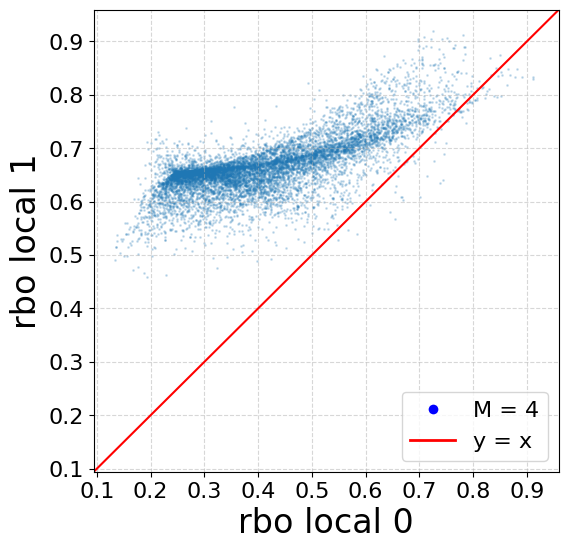

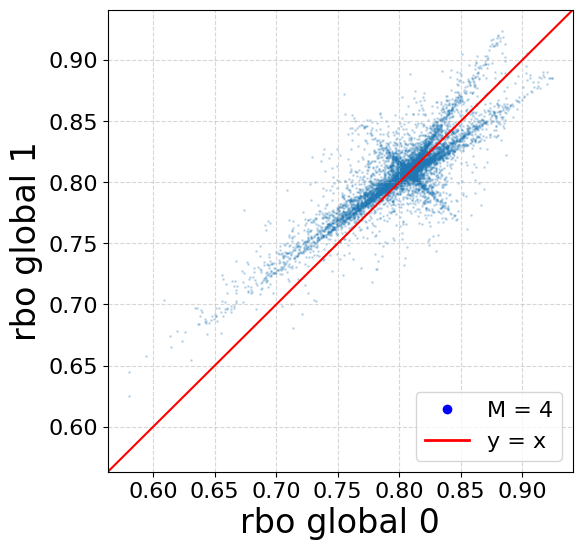

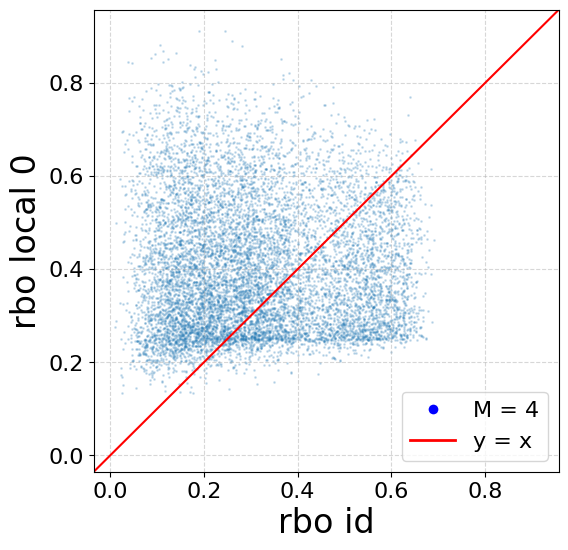

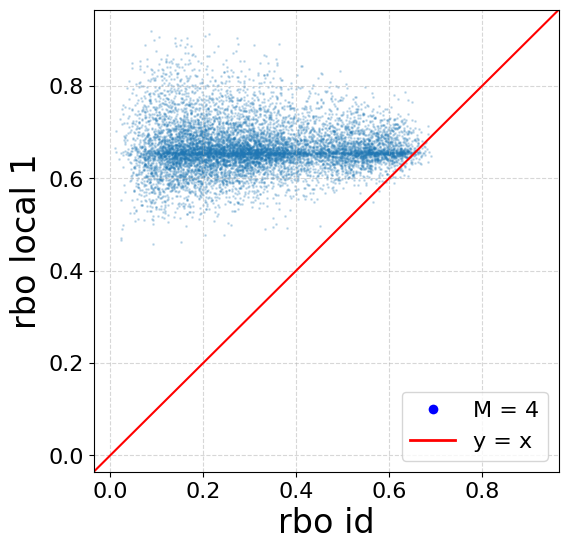

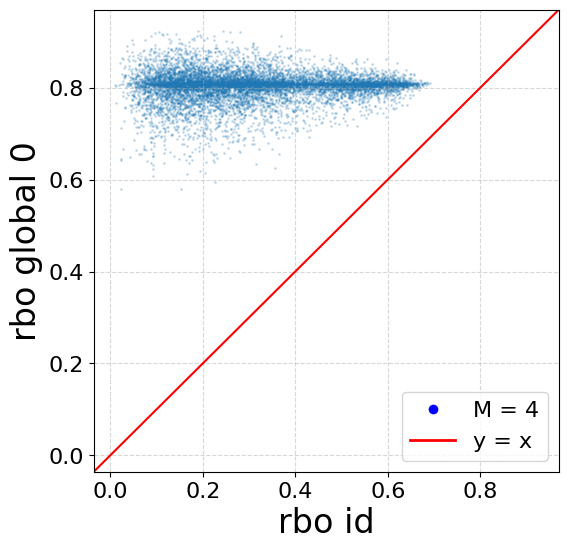

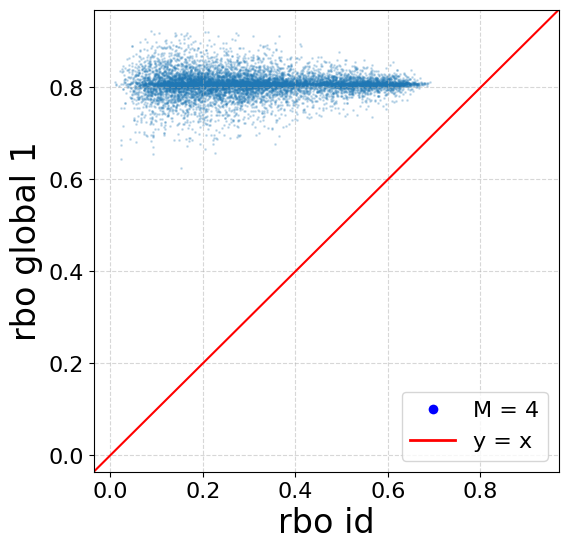

0.8


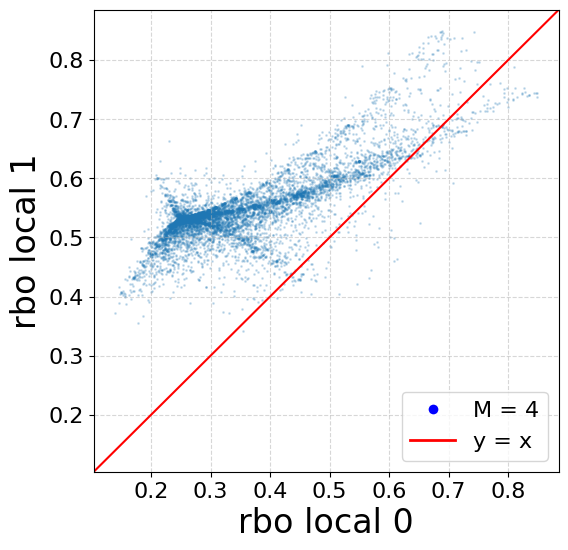

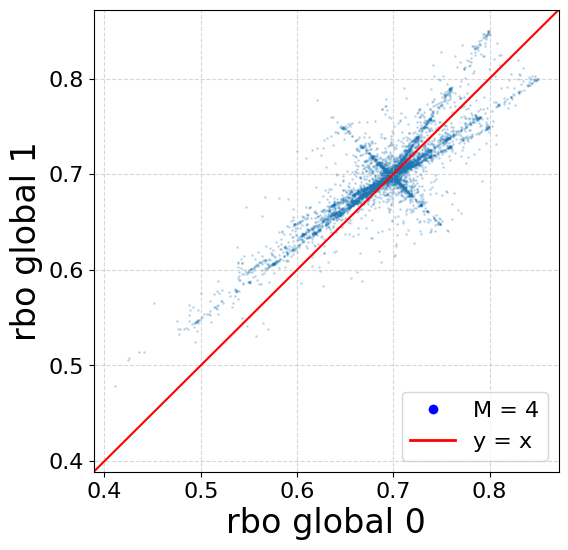

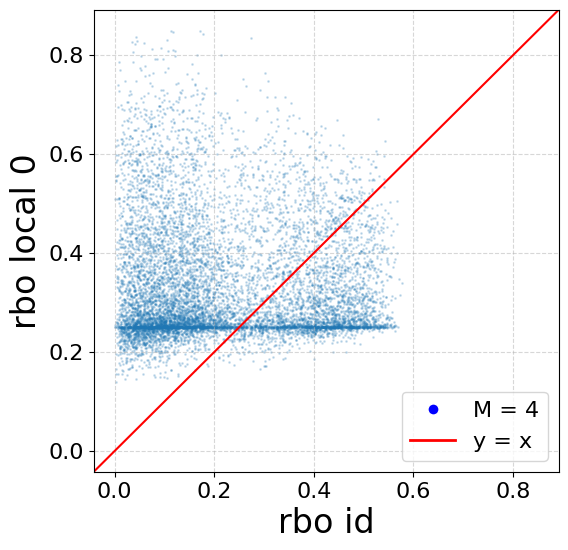

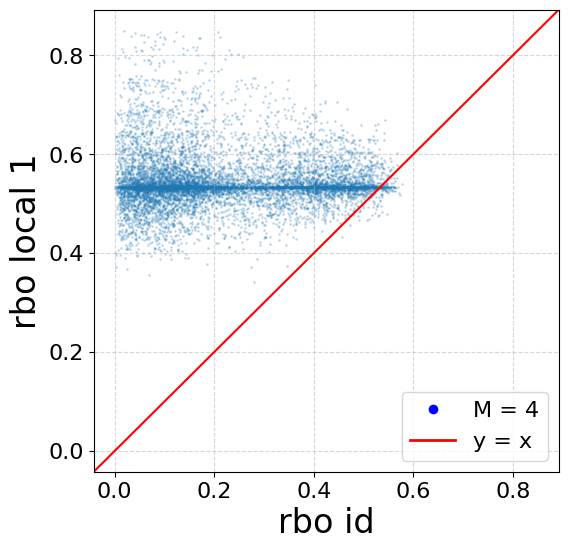

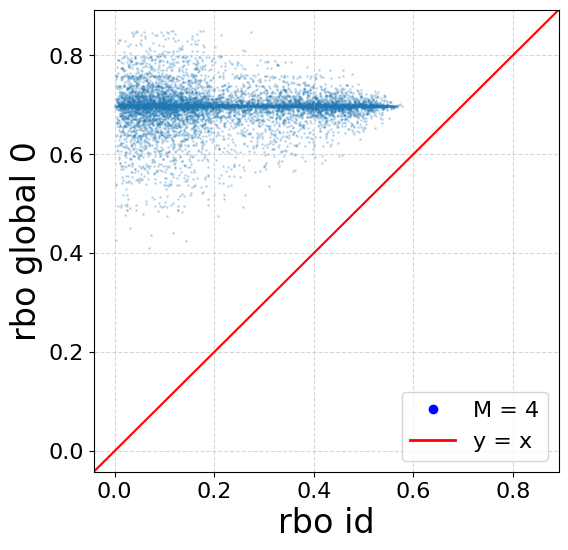

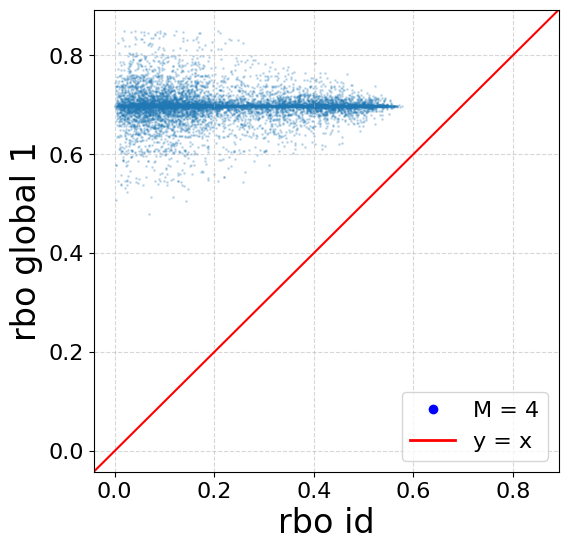

0.95


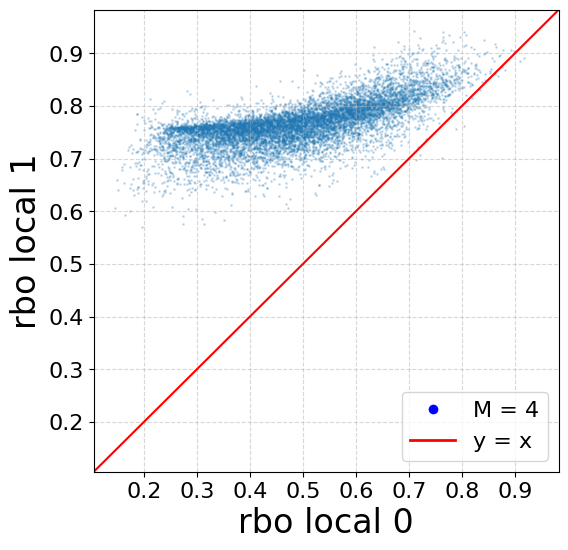

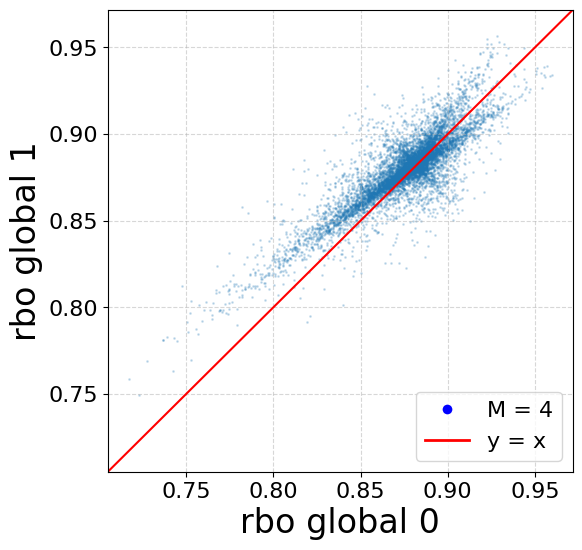

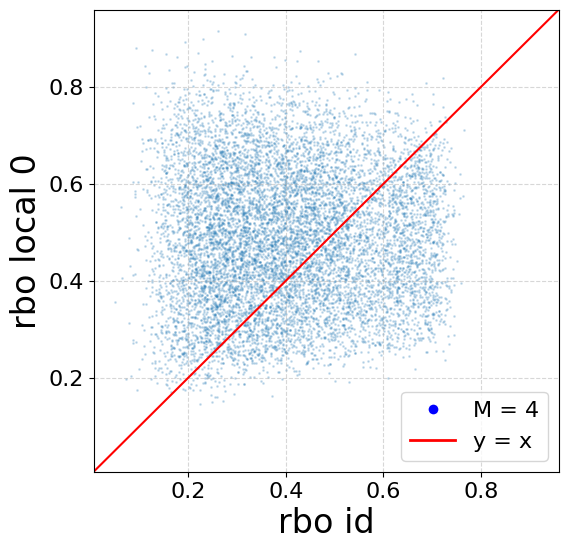

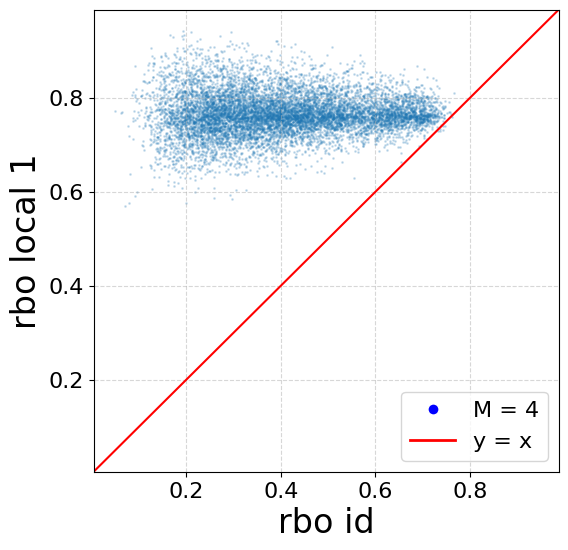

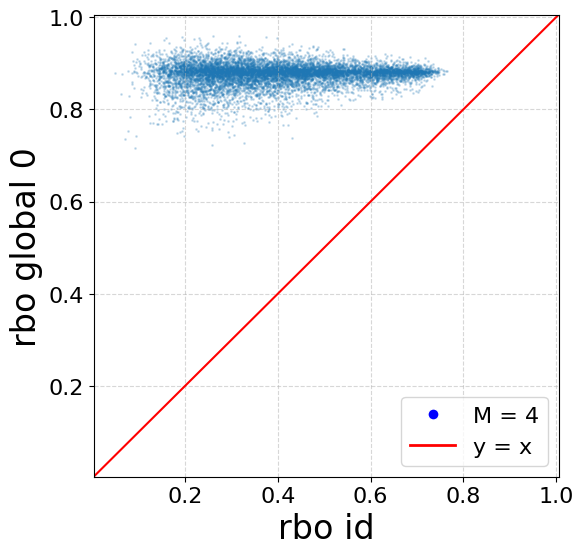

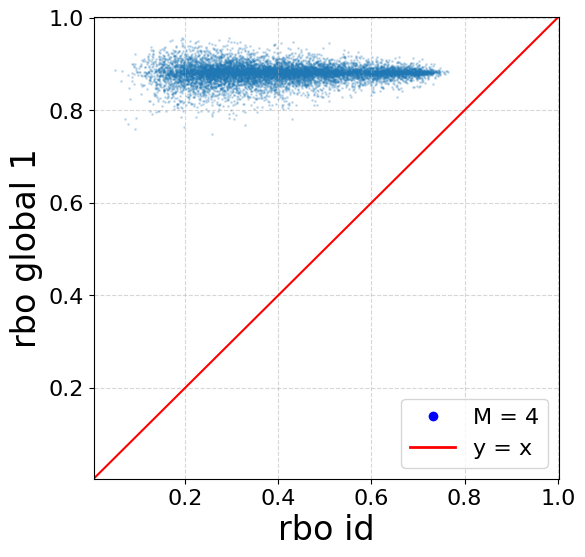

In [72]:
p_values = [.9,.8,.95]
df = pd.read_csv('./results/rel_dominated_data.csv')

for p in p_values:
    print(p)
    
    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_locals_0"], "rbo local 0", current["rbo_locals_1"], "rbo local 1",.2)

    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_globals_0"], "rbo global 0", current["rbo_globals_1"], "rbo global 1",.2)
    
    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_locals_0"], "rbo local 0",.2)
    
    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_locals_1"], "rbo local 1",.2)
    
    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_globals_0"], "rbo global 0",.2)
    
    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_globals_1"], "rbo global 1",.2)


0.9 110300 67350


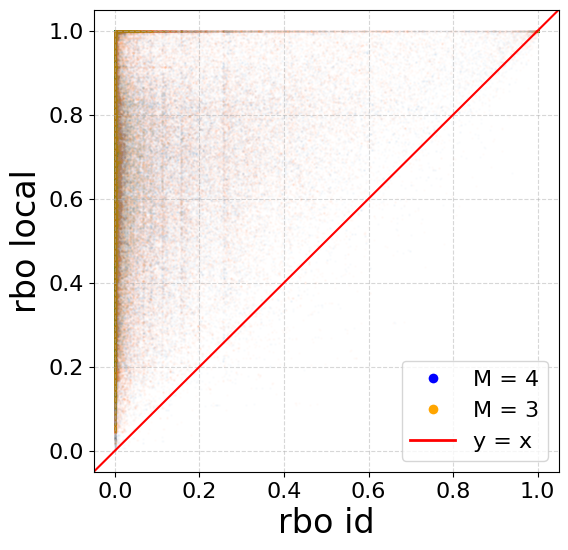

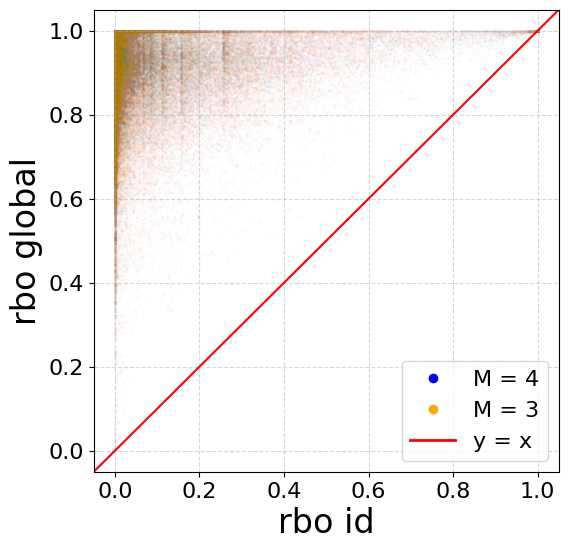

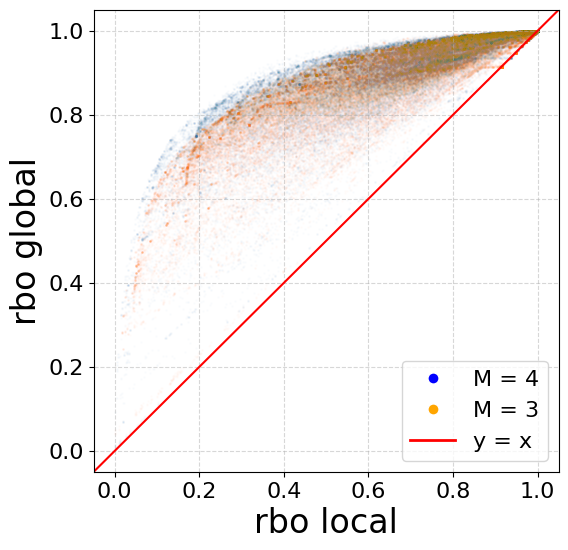

0.8 110300 67350


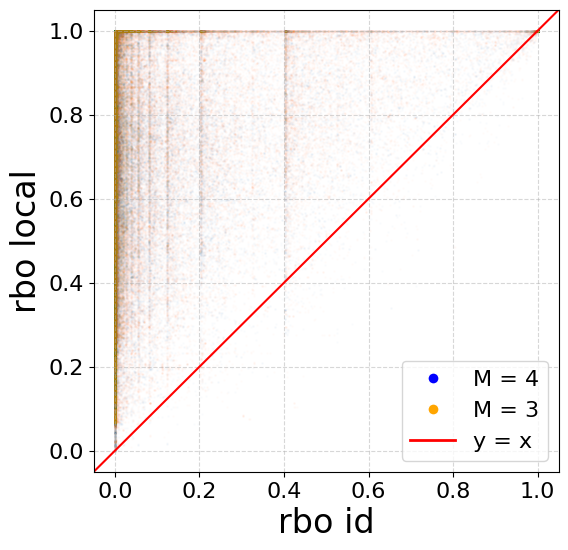

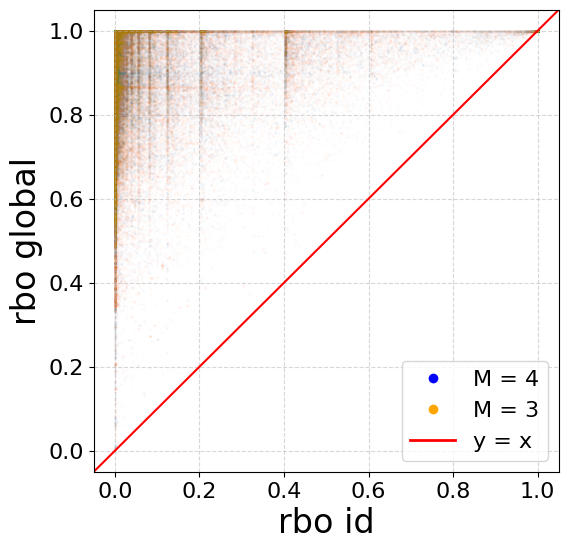

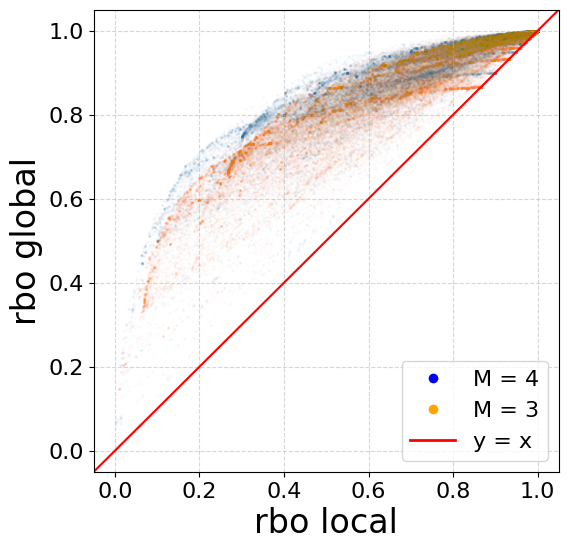

0.95 110300 67350


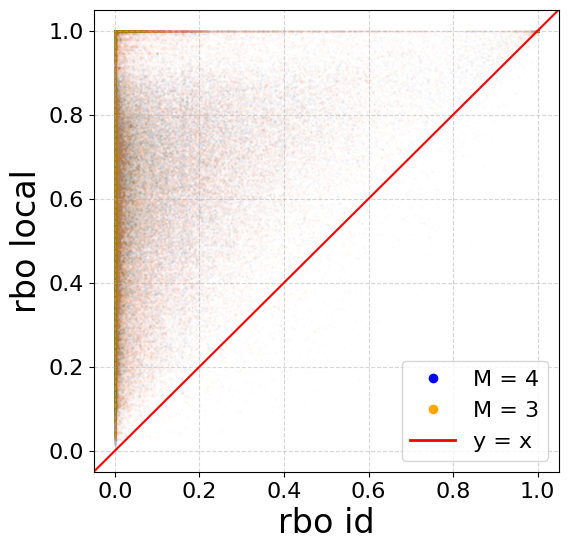

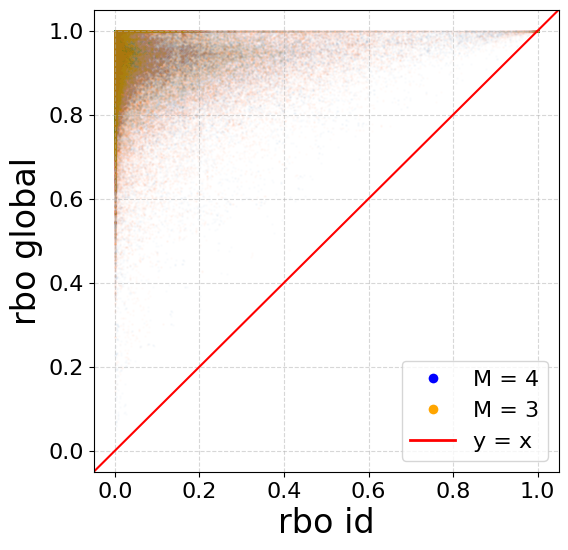

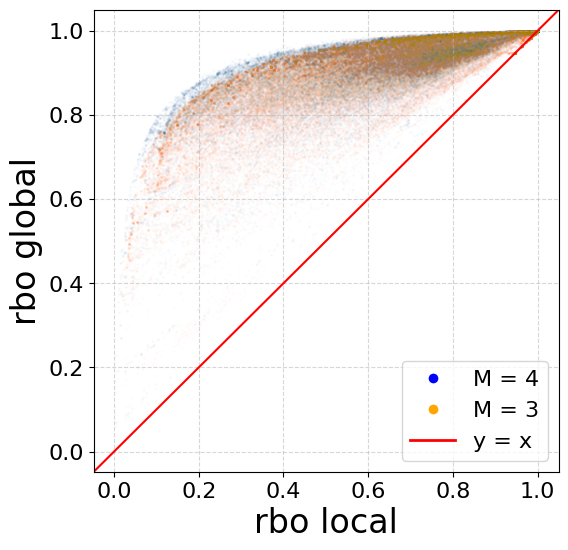

In [70]:
p_values = [.9,.8,.95]
df = pd.read_csv('./results/run_data.csv')

for p in p_values:    
    current = df[df['p_used'] == p]
    pre_2012 = current[current["year"]<2012]
    post_2012 = current[current["year"]>=2012]
    print(p,len(pre_2012),len(post_2012))
    compare_rbo_scores(post_2012["rbo_ids"], "rbo id", post_2012["rbo_locals"], "rbo local", data_x_2=pre_2012["rbo_ids"],data_y_2=pre_2012["rbo_locals"])
    compare_rbo_scores(post_2012["rbo_ids"], "rbo id", post_2012["rbo_globals"], "rbo global", data_x_2=pre_2012["rbo_ids"],data_y_2=pre_2012["rbo_globals"])
    compare_rbo_scores(post_2012["rbo_locals"], "rbo local", post_2012["rbo_globals"], "rbo global", data_x_2=pre_2012["rbo_locals"],data_y_2=pre_2012["rbo_globals"])

0.9


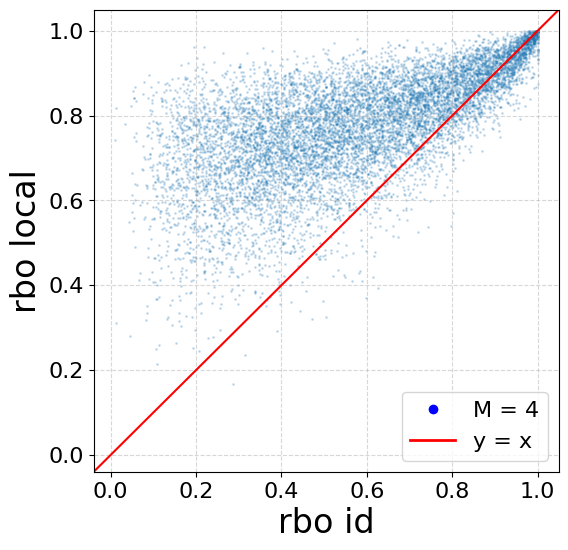

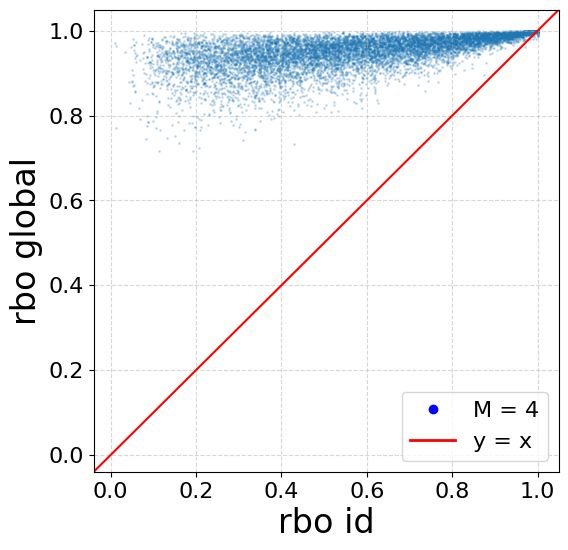

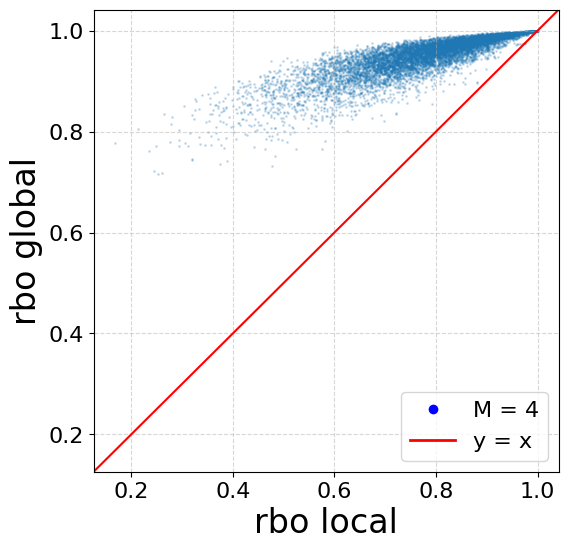

0.8


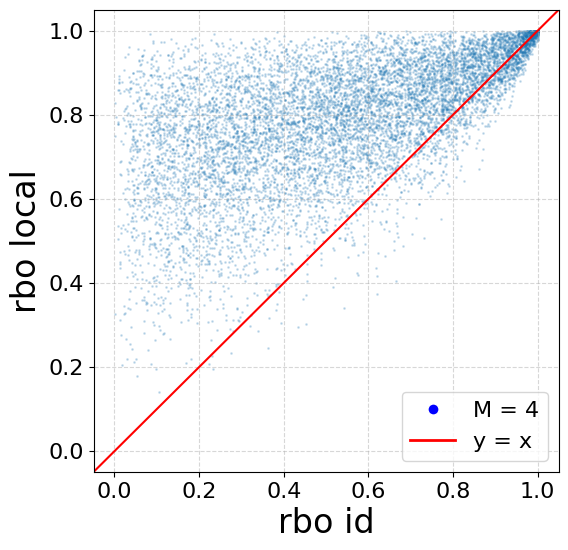

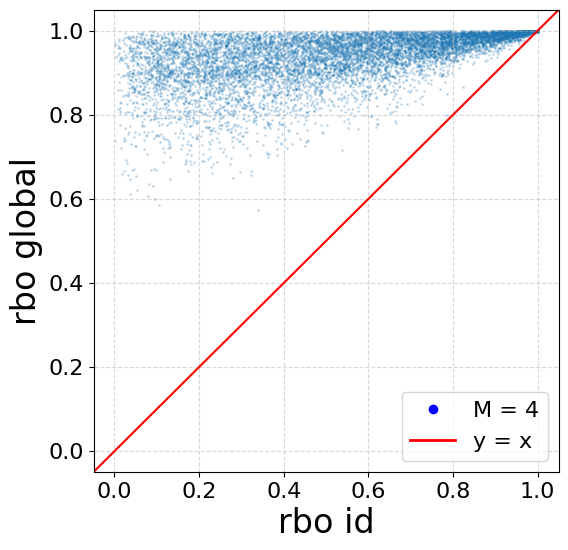

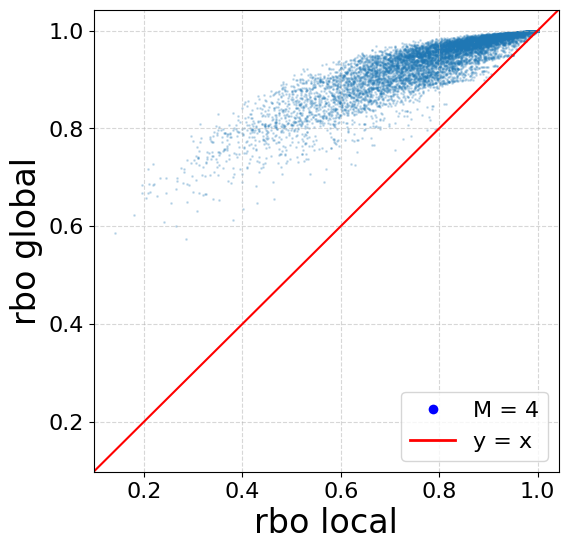

0.95


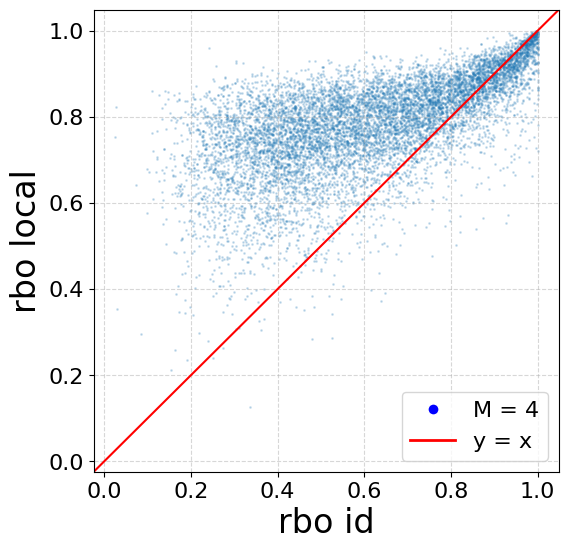

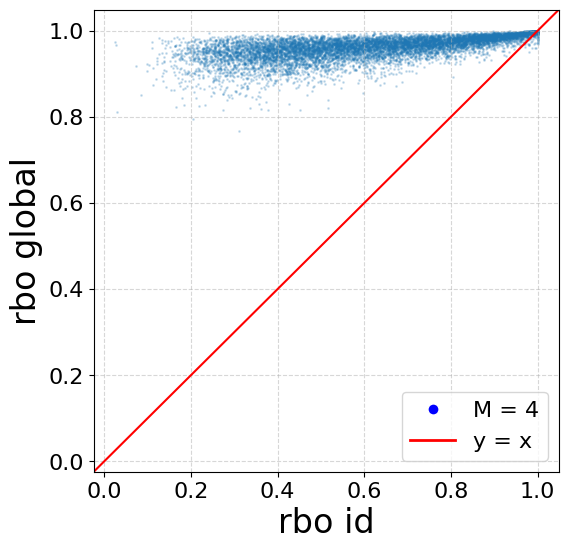

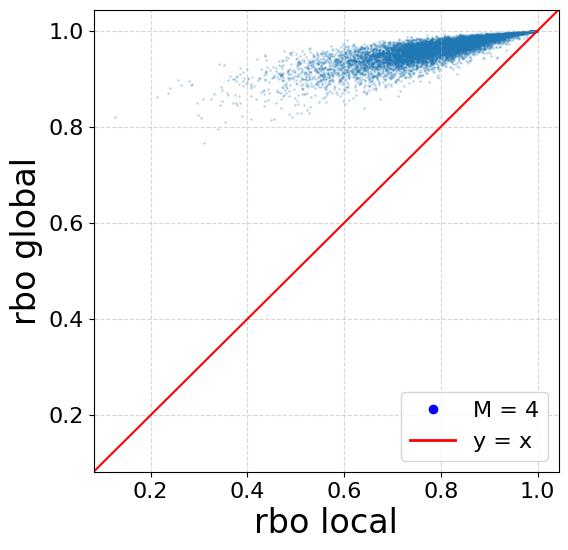

In [71]:
p_values = [.9,.8,.95]
df = pd.read_csv('./results/rel_2014_data.csv')

for p in p_values:    
    print(p)
    current = df[df['p_used'] == p]
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_locals"], "rbo local",.2)
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_globals"], "rbo global",.2)
    compare_rbo_scores(current["rbo_locals"], "rbo local", current["rbo_globals"], "rbo global",.2)

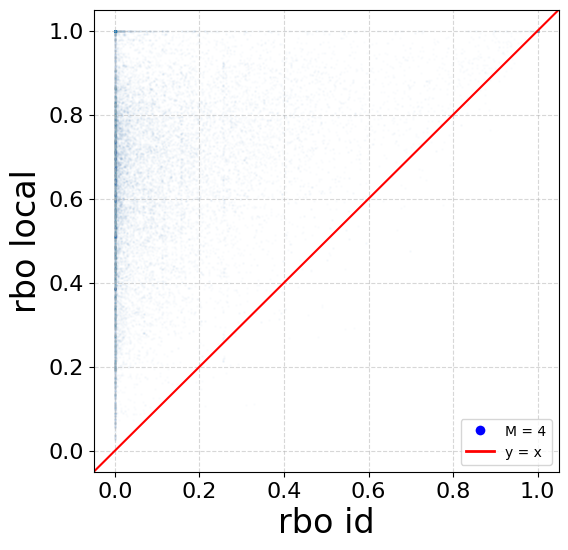

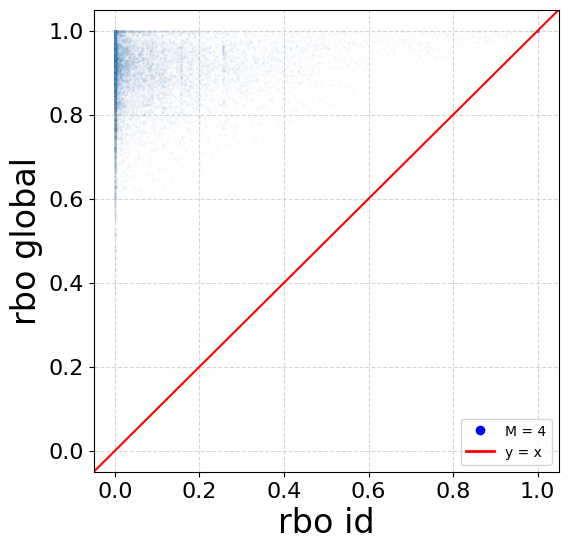

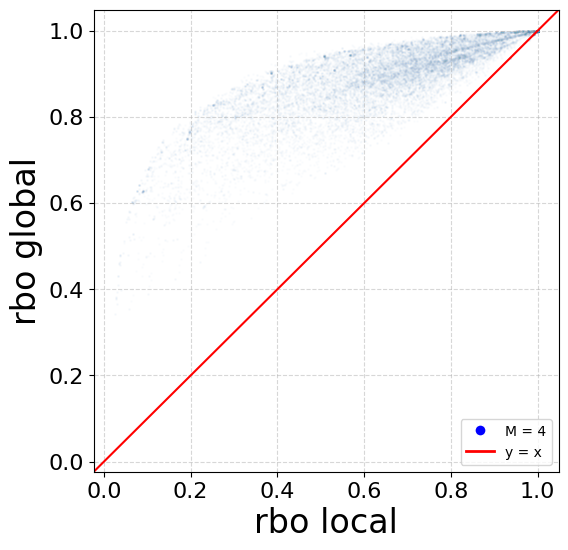

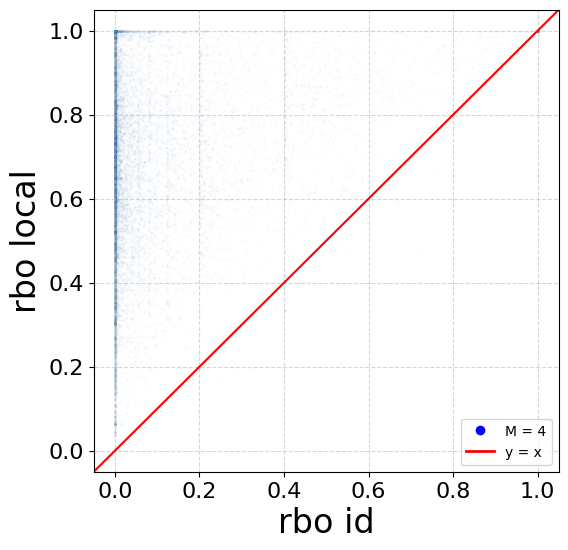

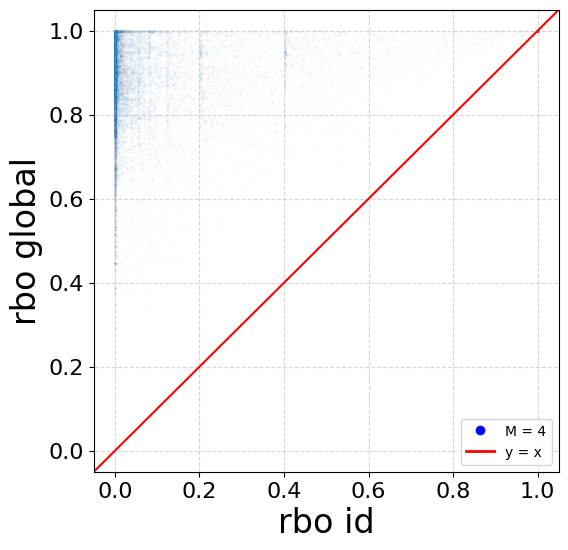

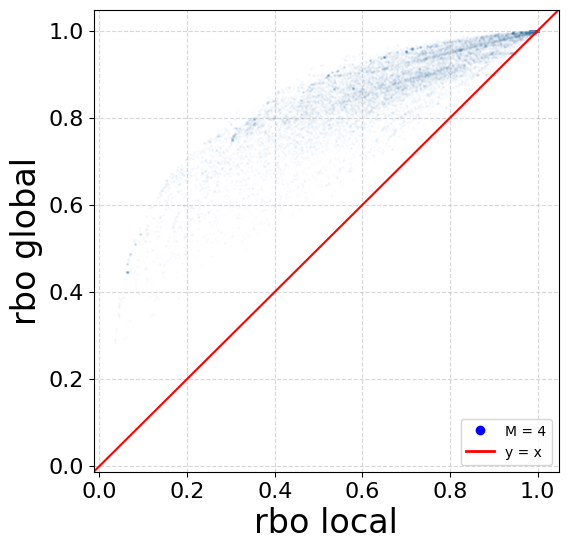

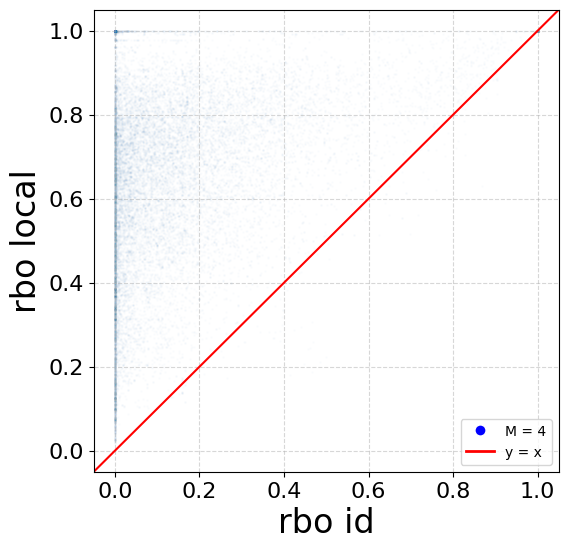

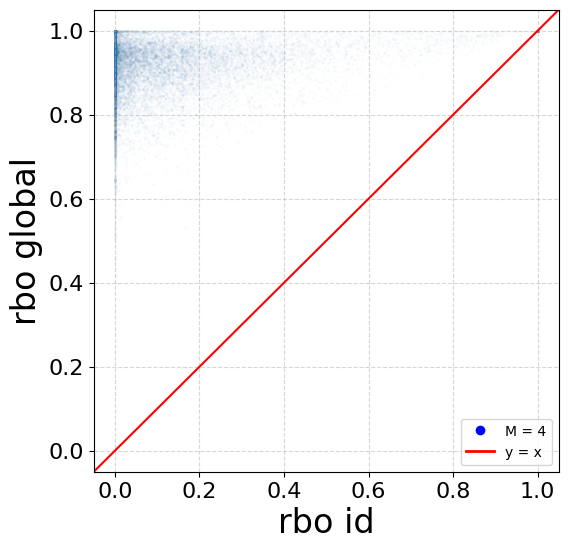

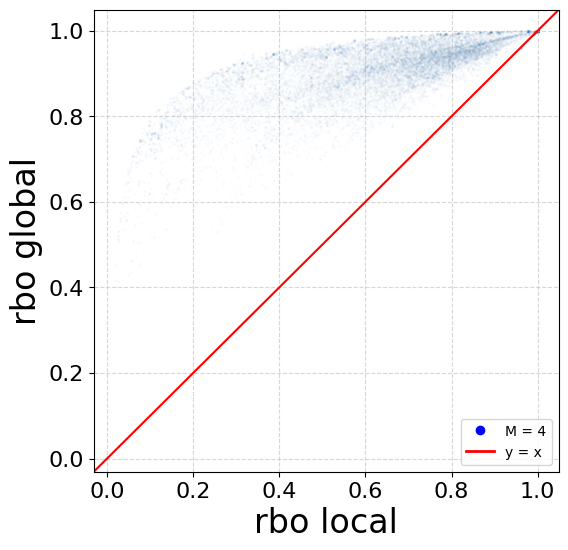

In [60]:
p_values = [.9,.8,.95]
df = pd.read_csv('./results/run_data.csv')

for p in p_values:    
    current = df[df['p_used'] == p]
    current = current[current['year'] == 2014]
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_locals"], "rbo local")
    compare_rbo_scores(current["rbo_ids"], "rbo id", current["rbo_globals"], "rbo global")
    compare_rbo_scores(current["rbo_locals"], "rbo local", current["rbo_globals"], "rbo global")

0.9


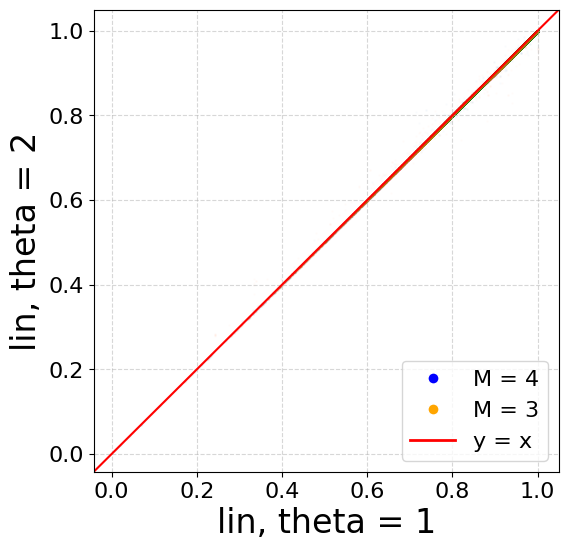

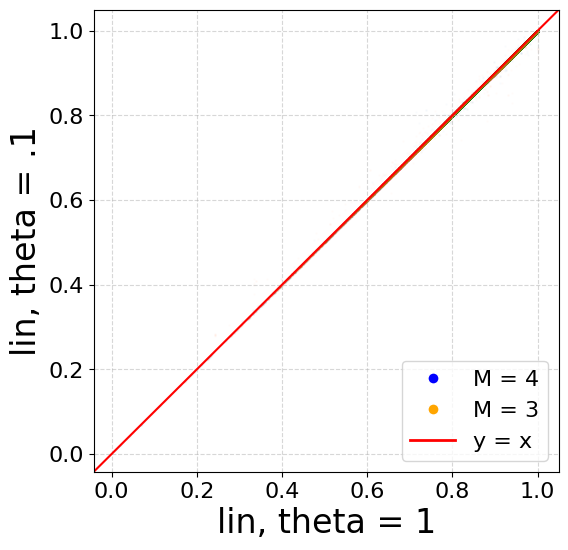

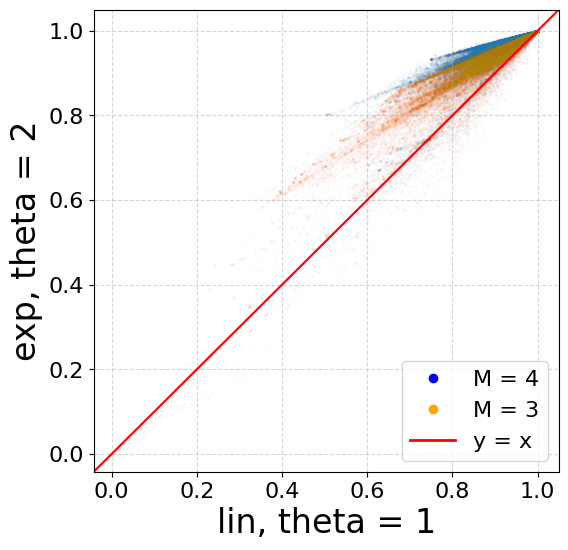

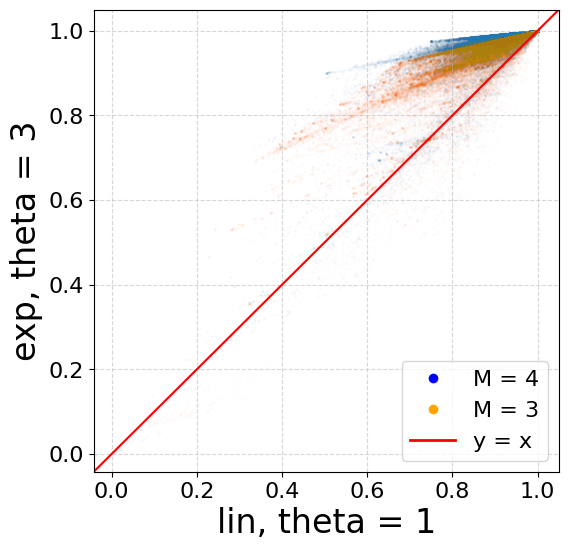

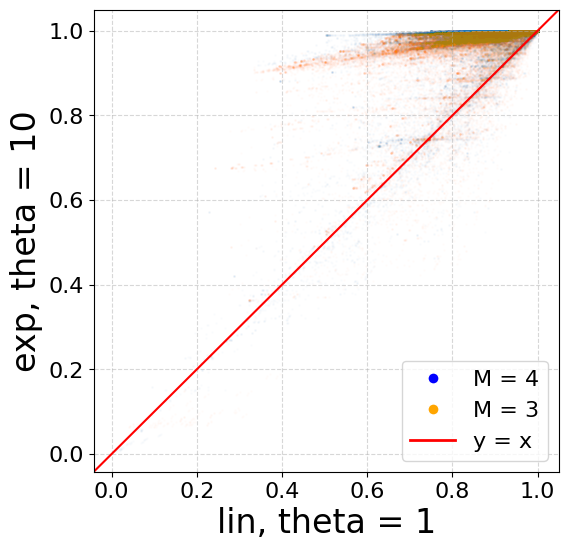

...

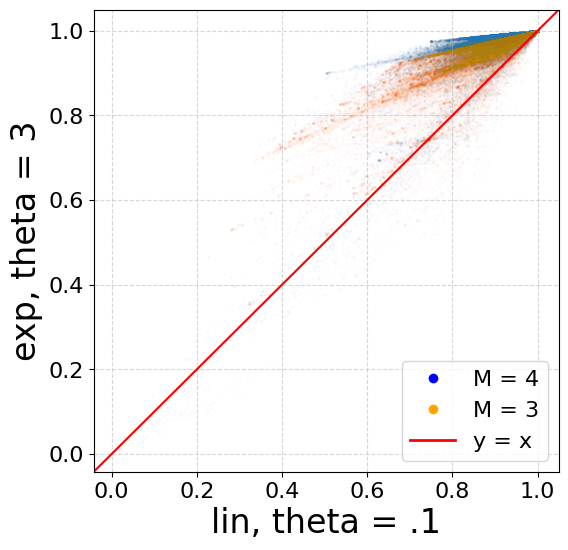

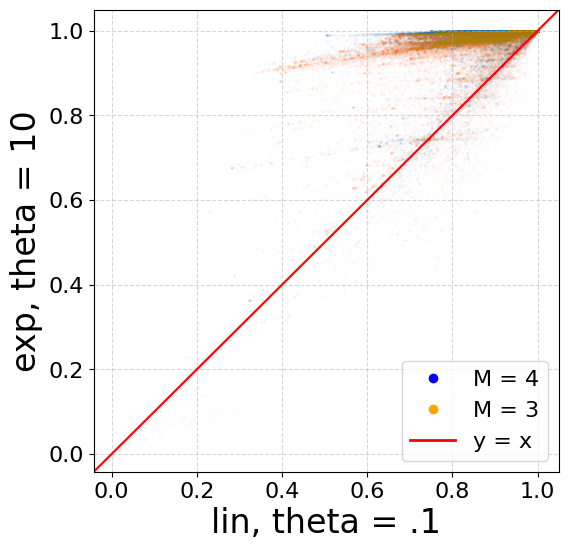

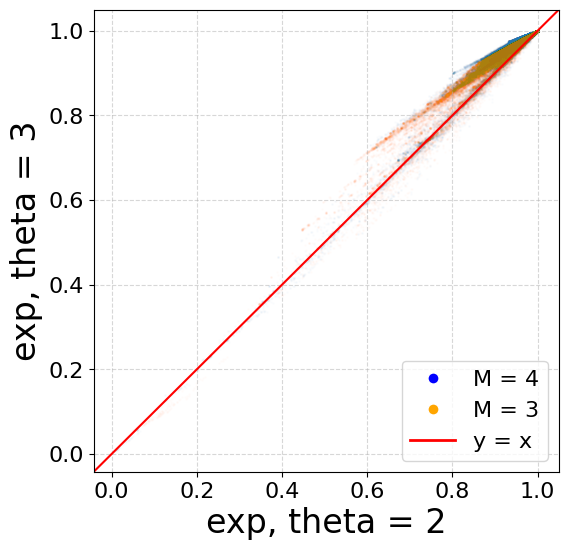

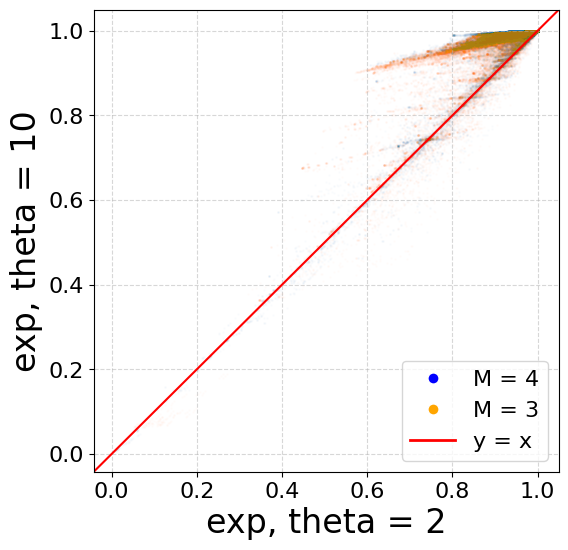

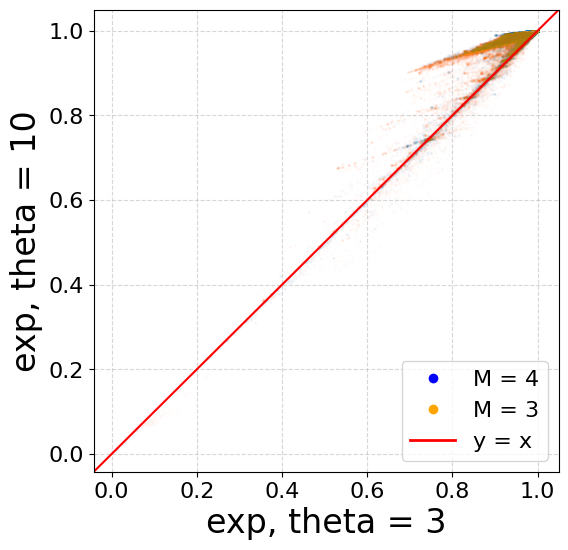

0.8


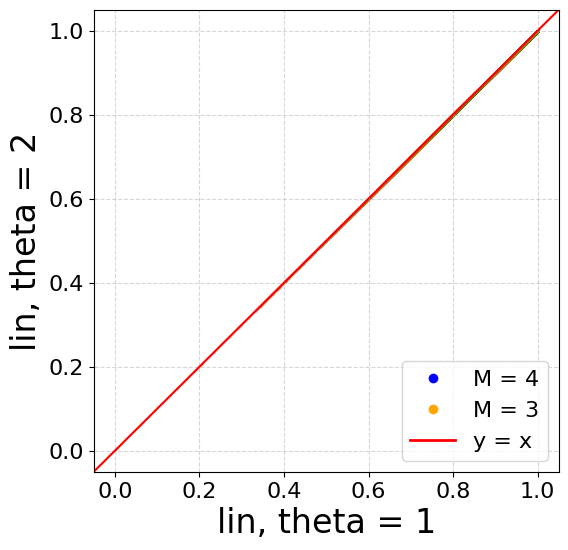

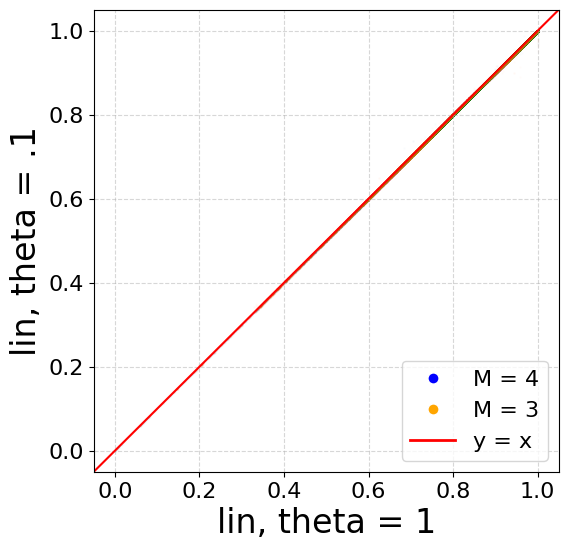

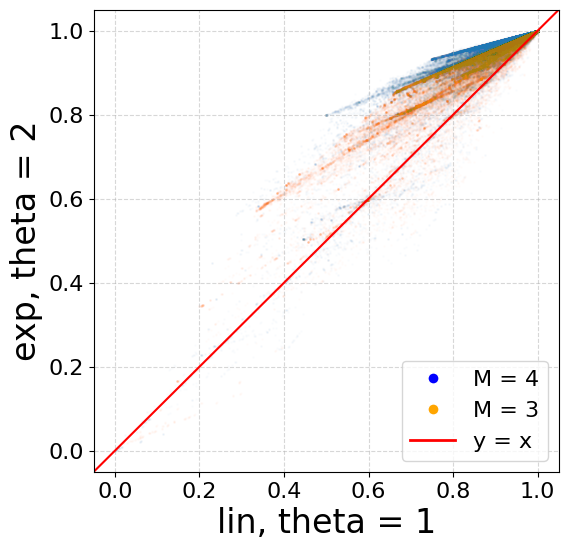

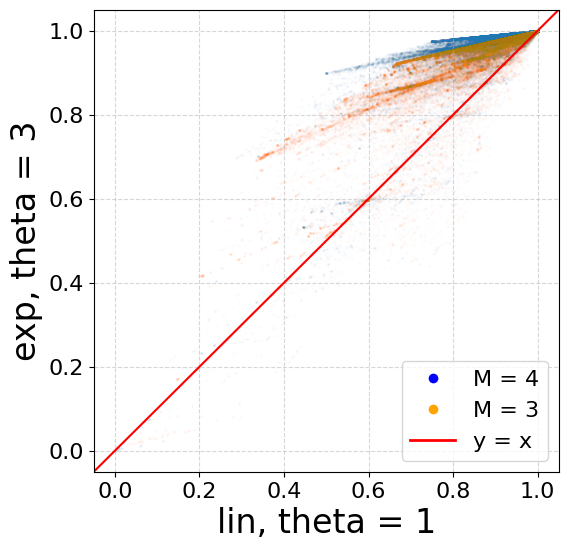

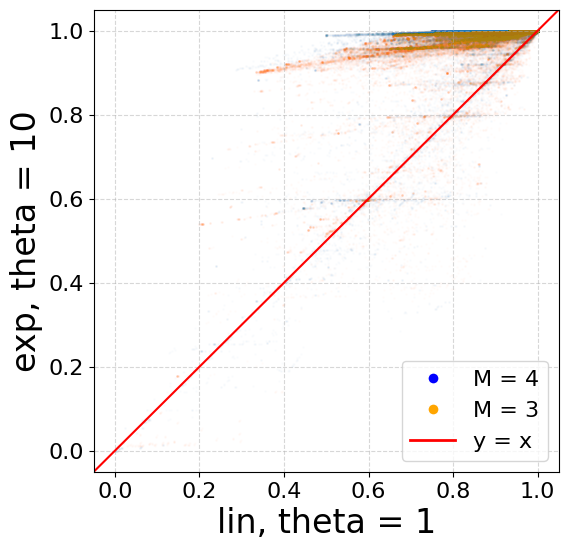

...

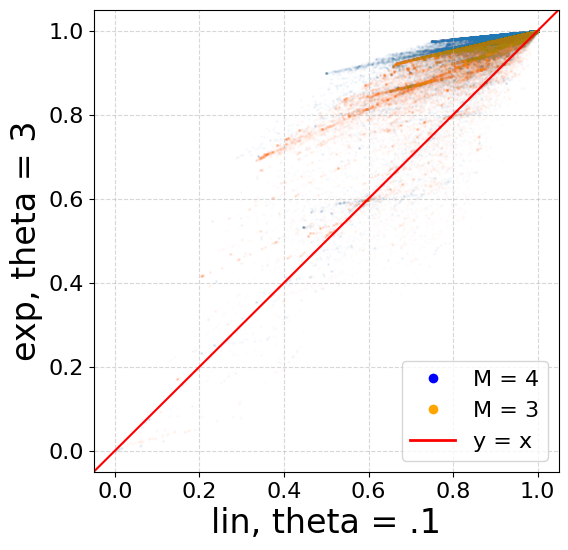

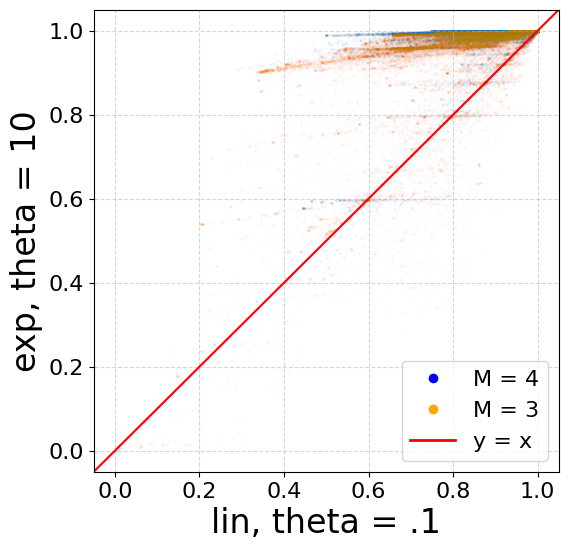

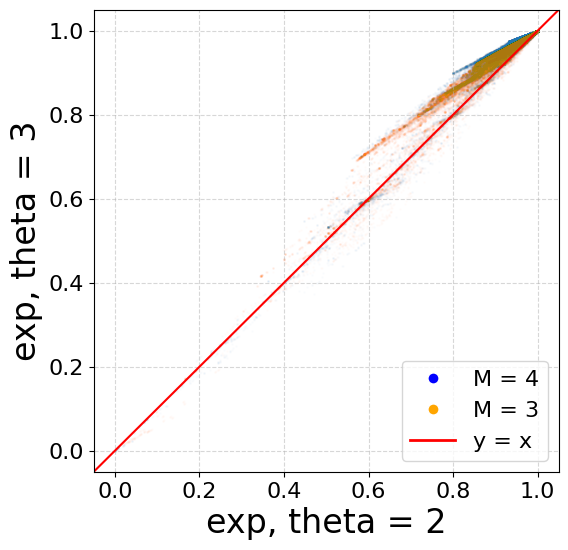

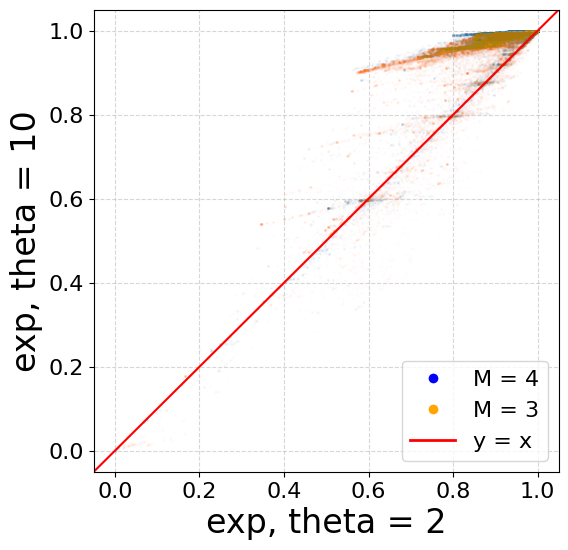

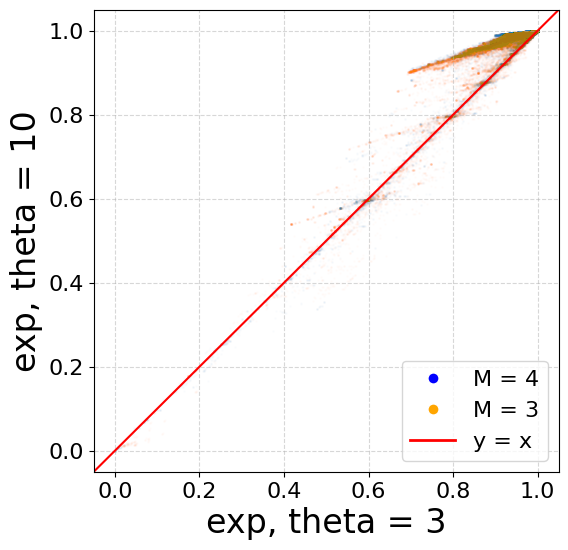

0.95


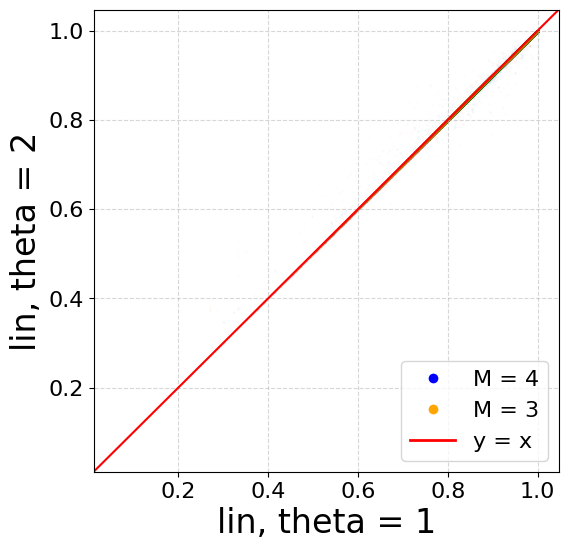

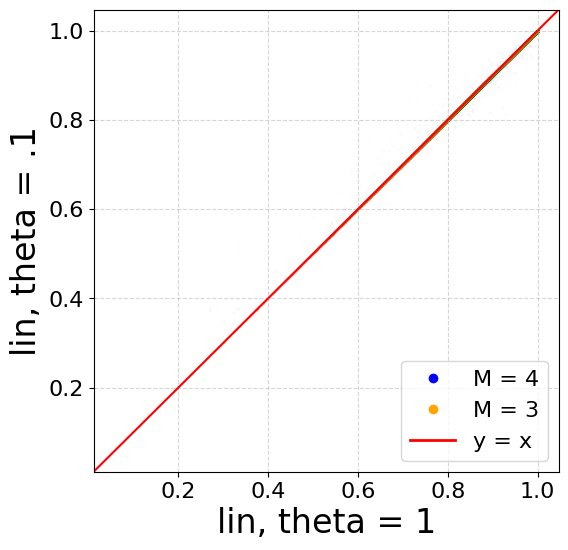

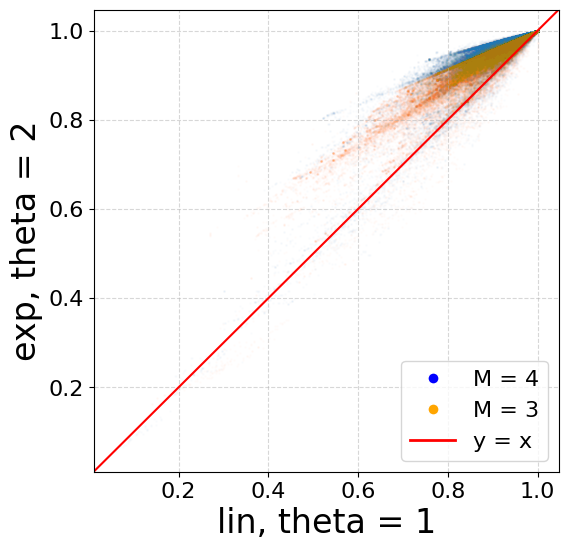

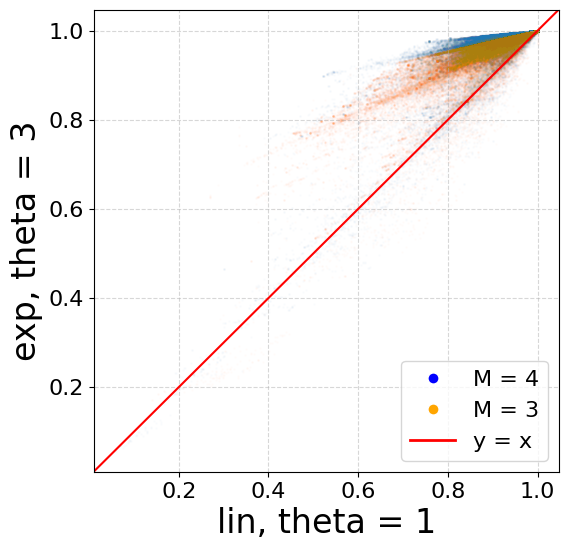

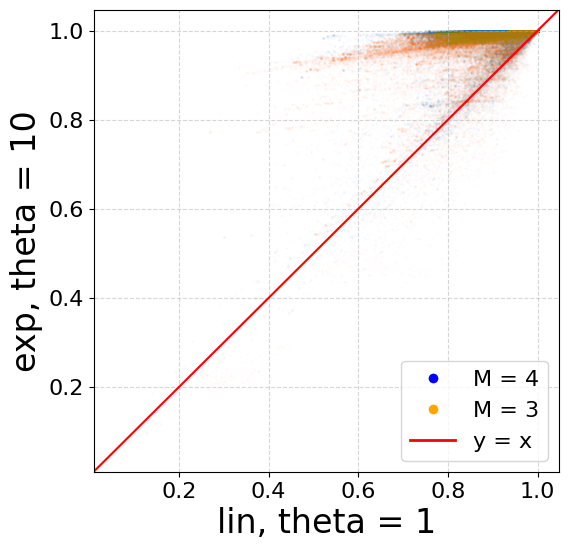

...

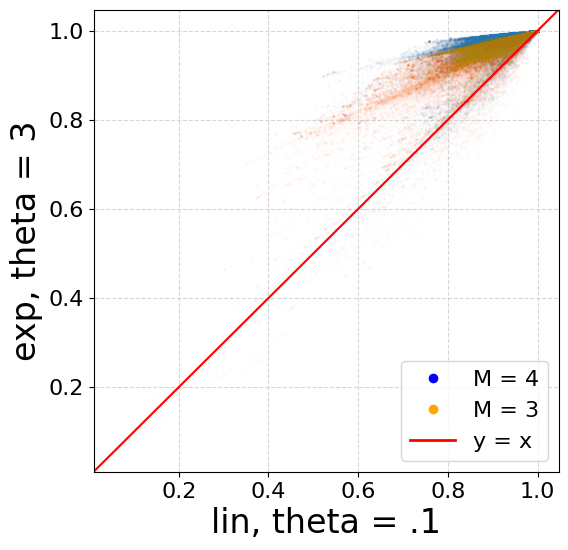

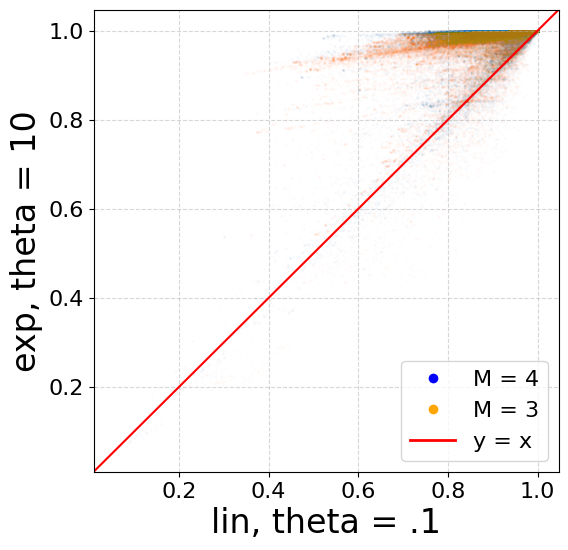

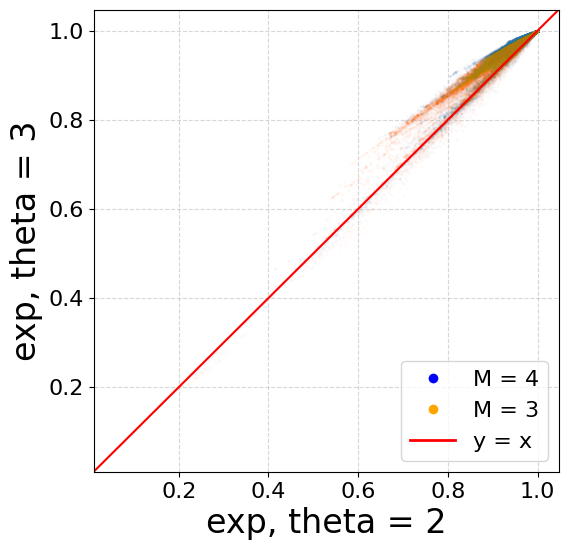

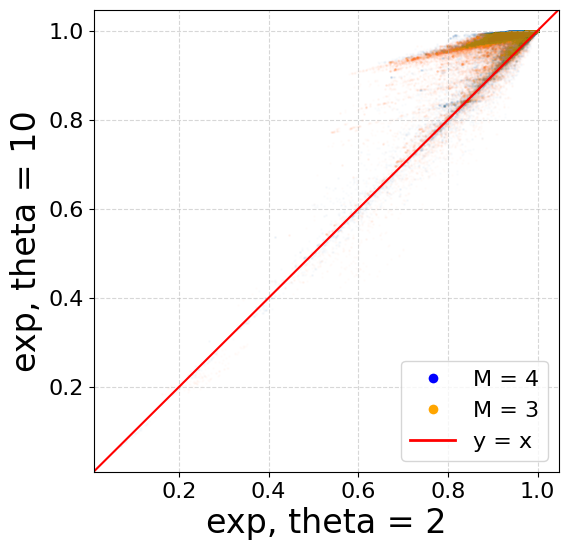

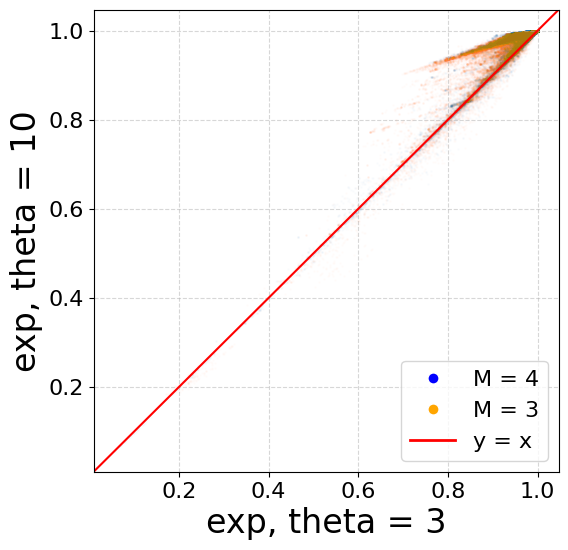

In [8]:
options = [("linear_gain_2_","lin, theta = 2"),("linear_gain_decimal_","lin, theta = .1"),("exponential_gain_2_","exp, theta = 2"),("exponential_gain_3_","exp, theta = 3"),("exponential_gain_10_","exp, theta = 10")]
p_values = [.9,.8,.95]
df = pd.read_csv('./results/run_data.csv')

for p in p_values:
    print(p)
    for o in options:
        current = df[df['p_used'] == p]
        pre_2012 = current[current["year"]<2012]
        post_2012 = current[current["year"]>=2012]
        compare_rbo_scores(post_2012["rbo_globals"], "lin, theta = 1",post_2012[f"{o[0]}global"], o[1],data_x_2=pre_2012["rbo_globals"],data_y_2=pre_2012[f"{o[0]}global"])

    for x in np.arange(len(options)):
        for y in np.arange(x+1,len(options)):
            current = df[df['p_used'] == p]
            pre_2012 = current[current["year"]<2012]
            post_2012 = current[current["year"]>=2012]
            compare_rbo_scores(post_2012[f"{options[x][0]}global"], options[x][1],post_2012[f"{options[y][0]}global"], options[y][1], data_x_2=pre_2012[f"{options[x][0]}global"], data_y_2=pre_2012[f"{options[y][0]}global"])    

0.9


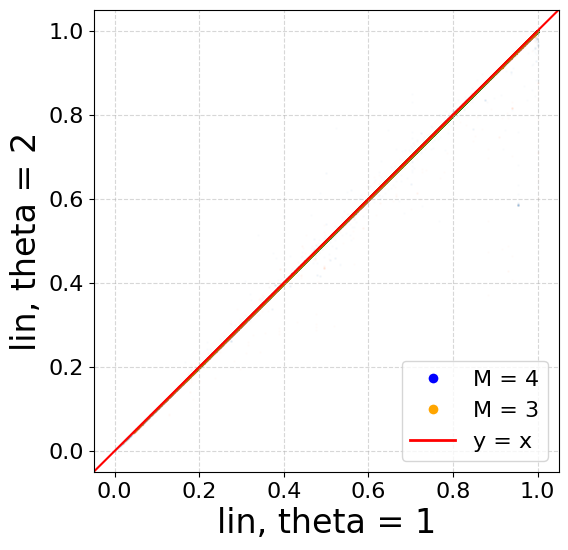

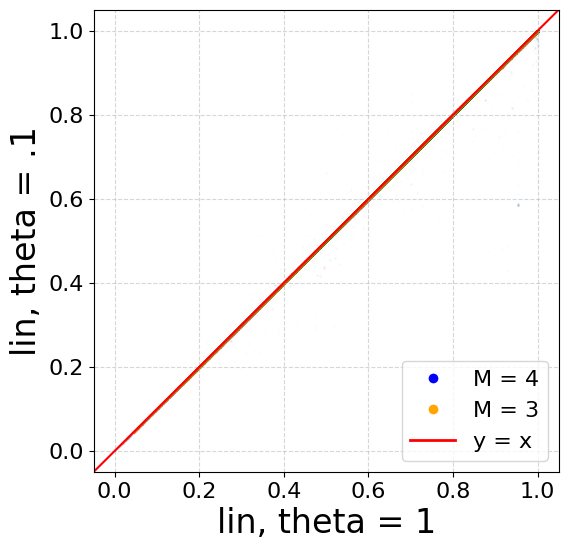

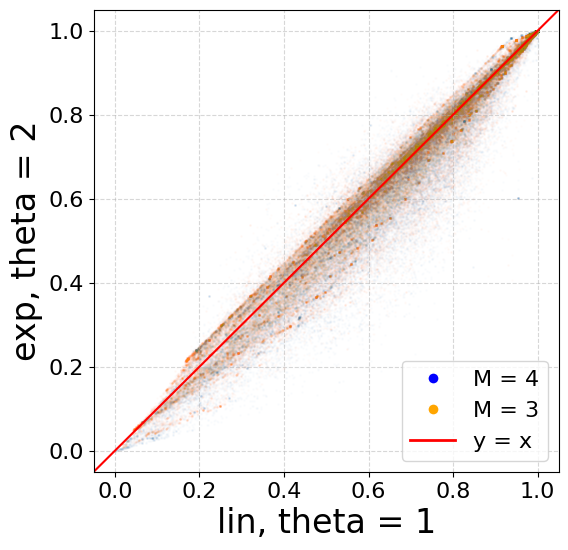

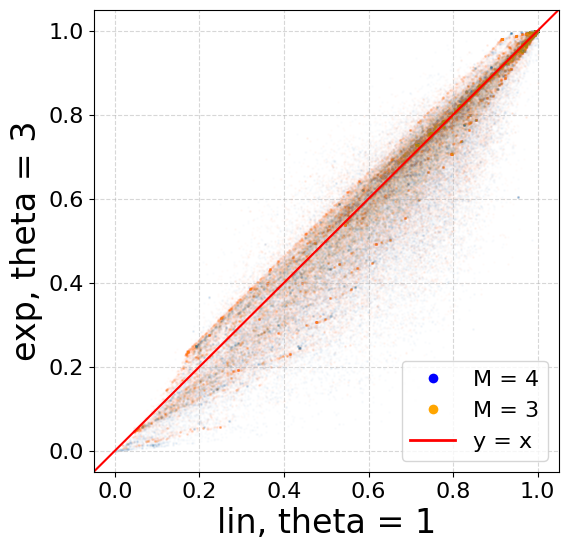

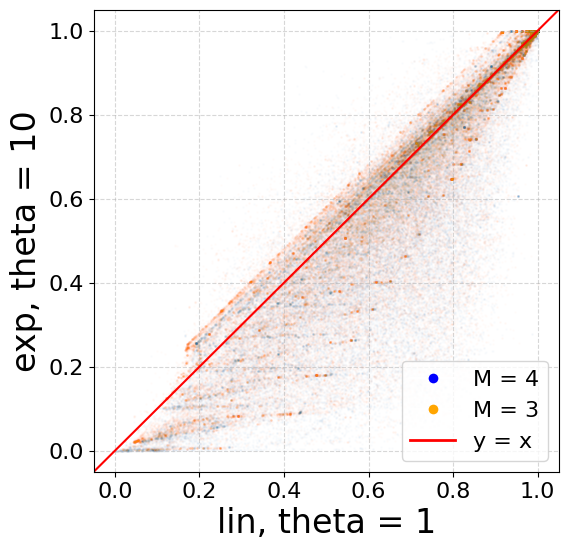

...

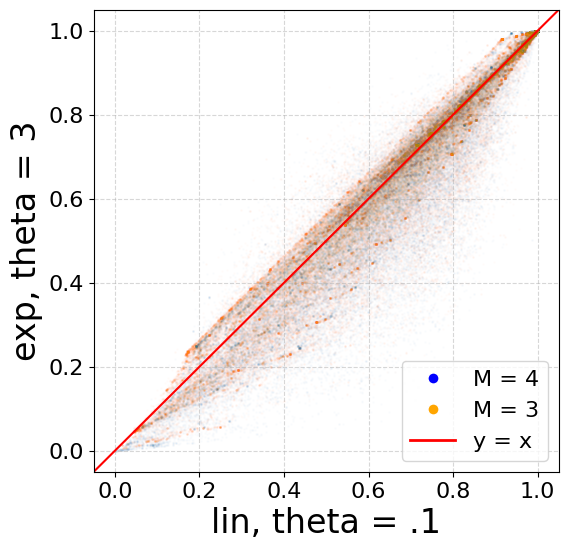

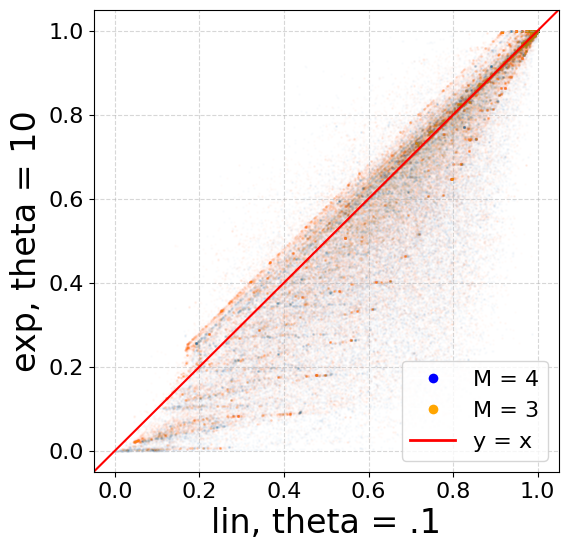

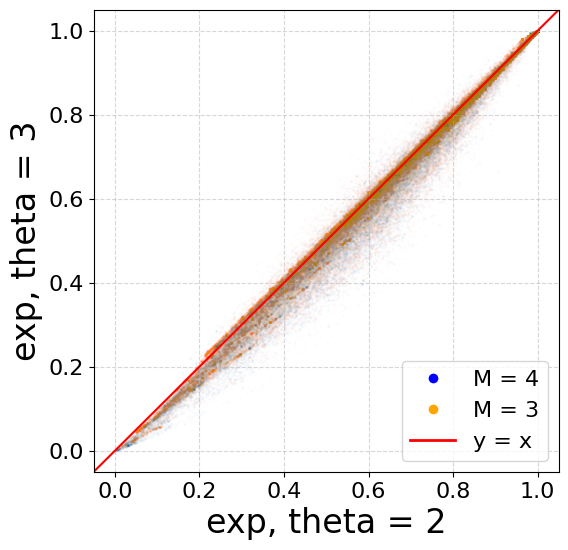

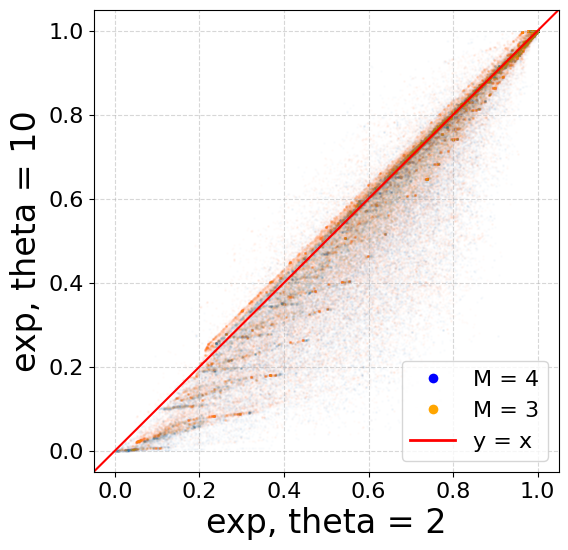

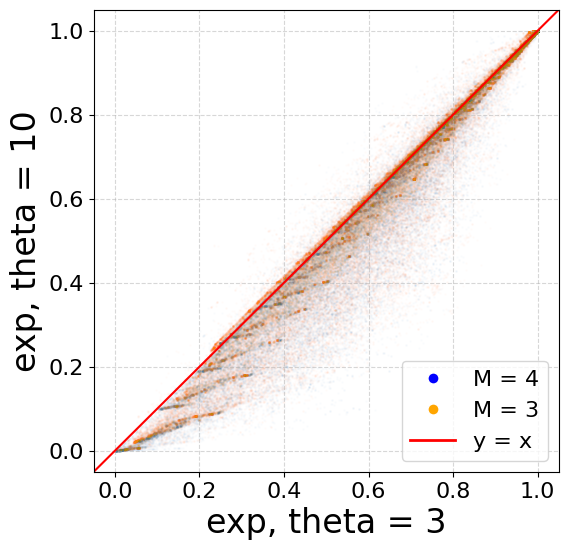

0.8


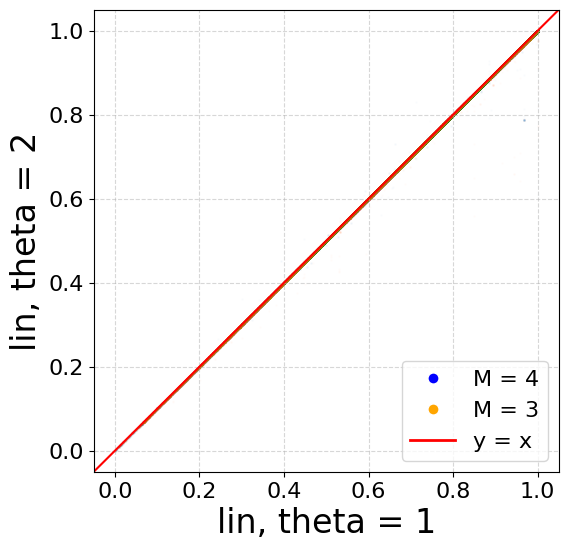

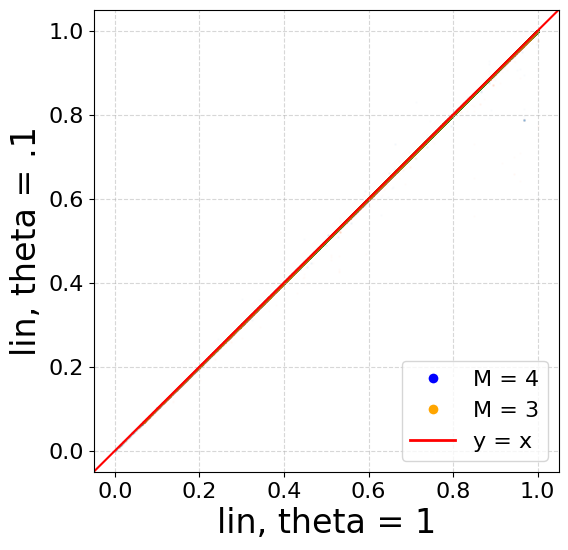

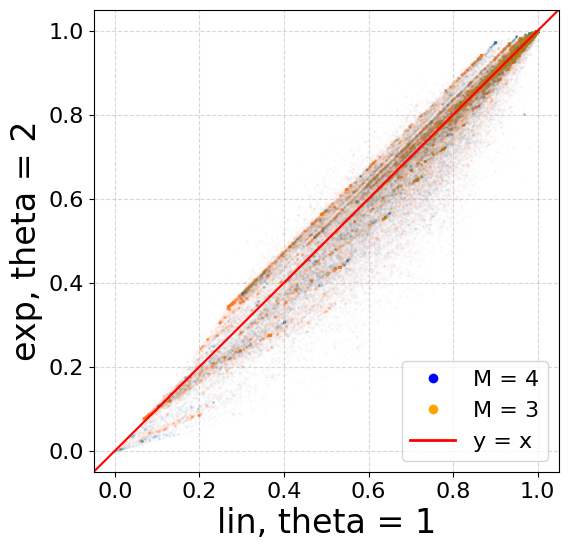

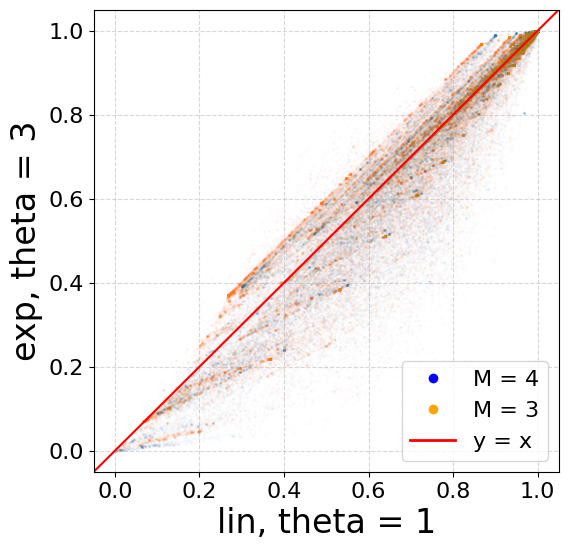

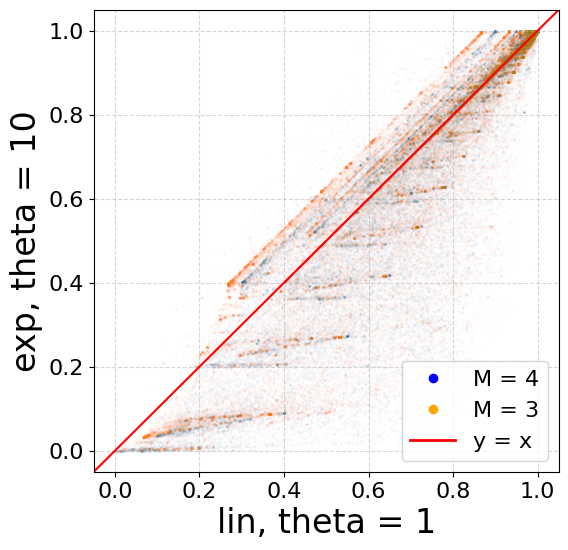

...

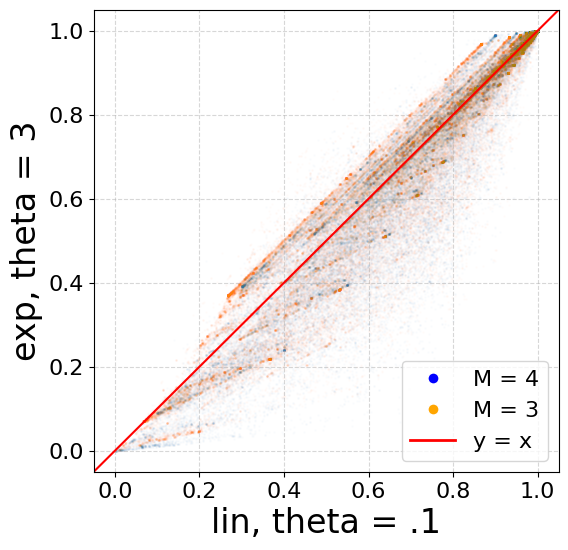

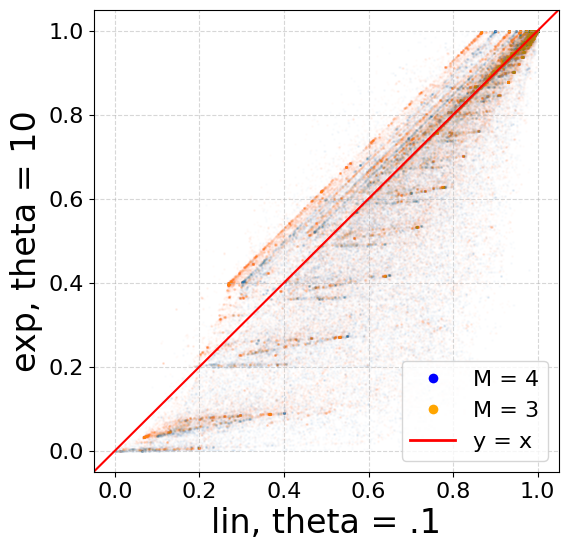

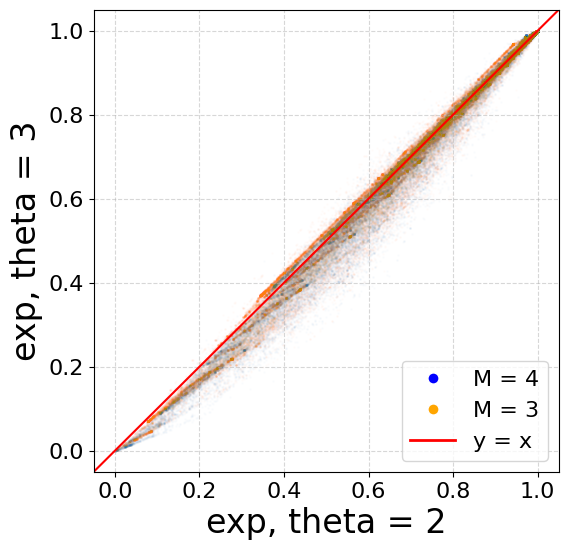

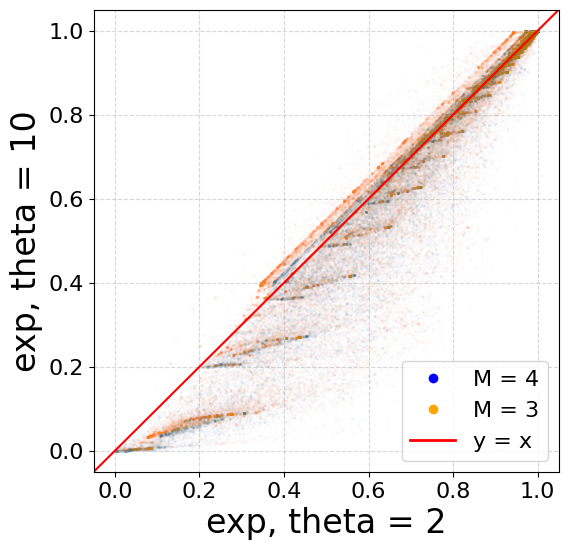

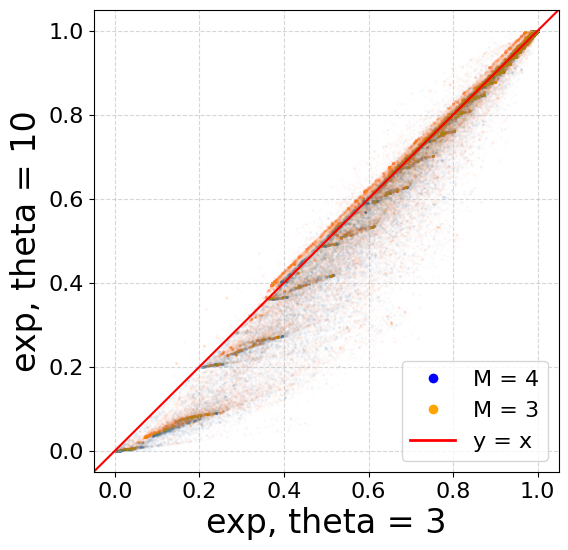

0.95


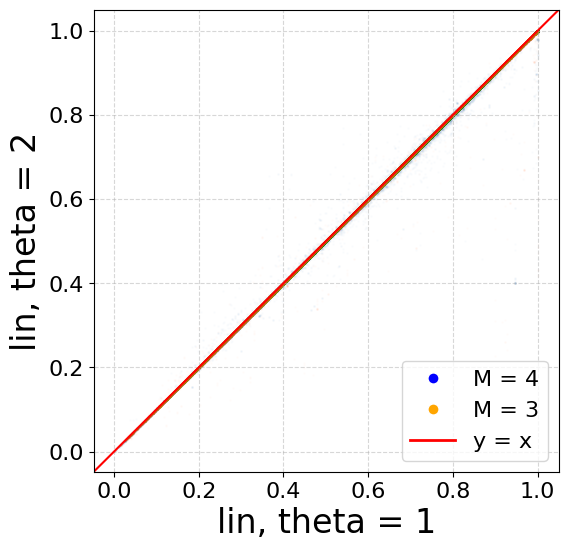

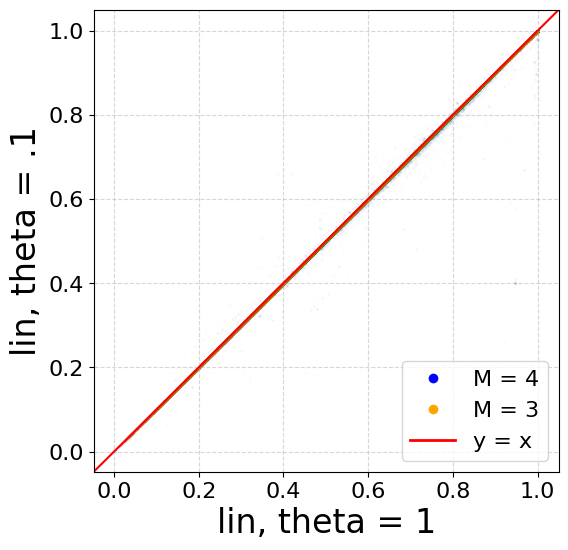

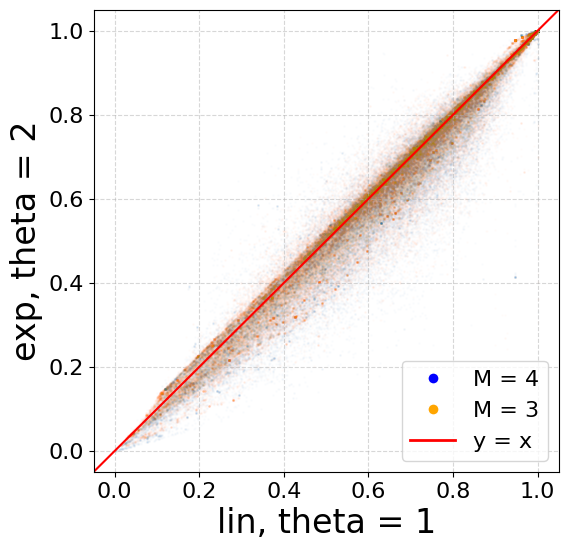

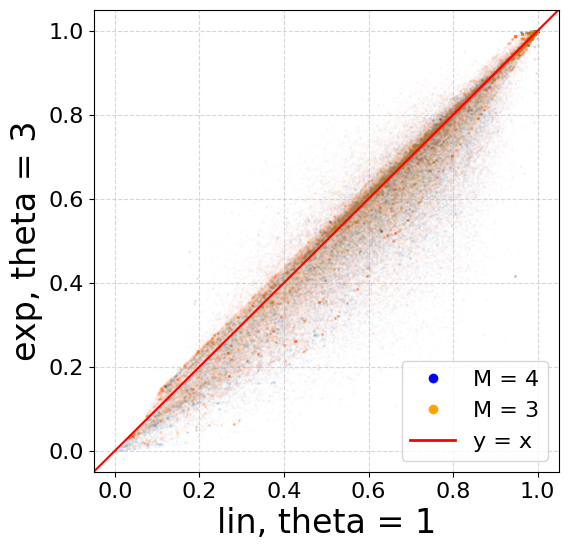

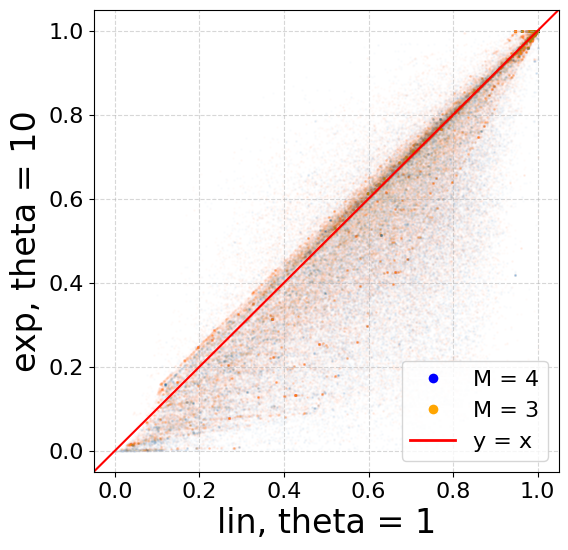

...

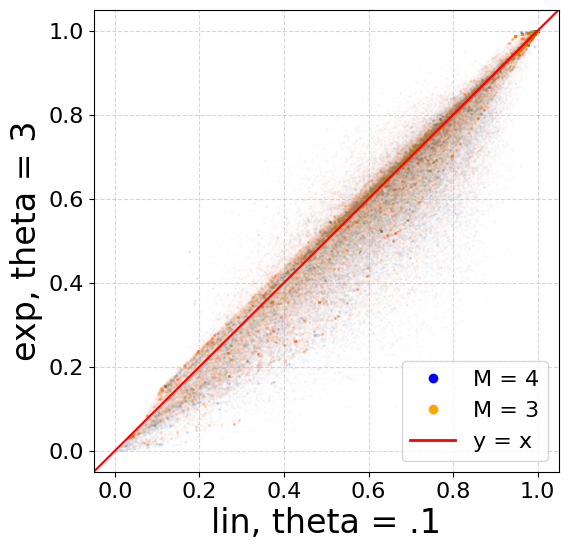

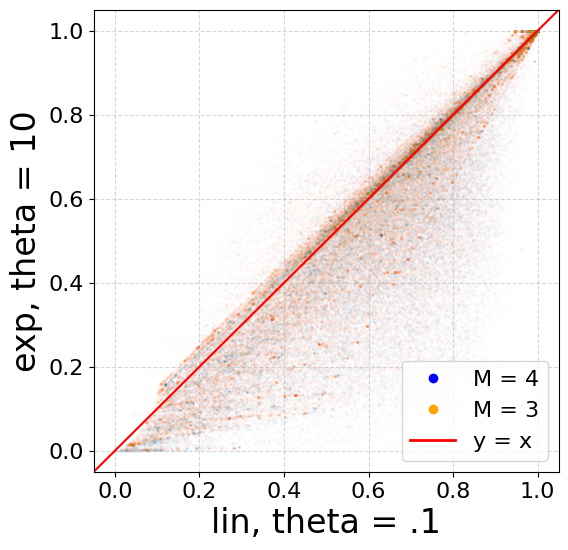

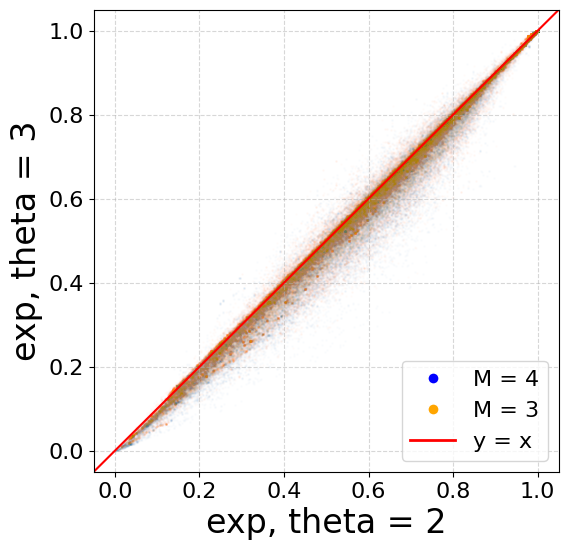

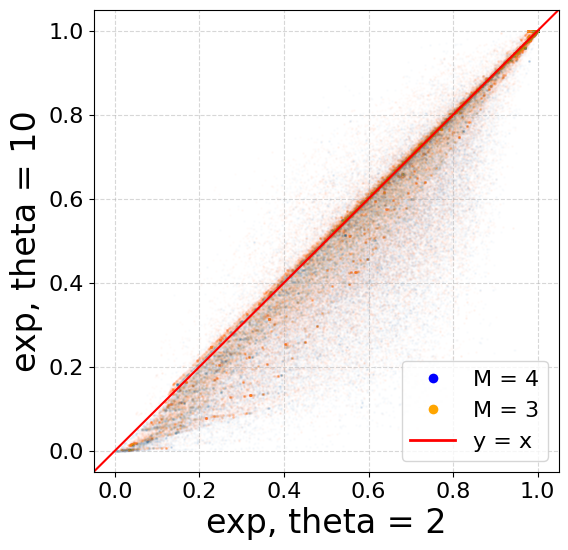

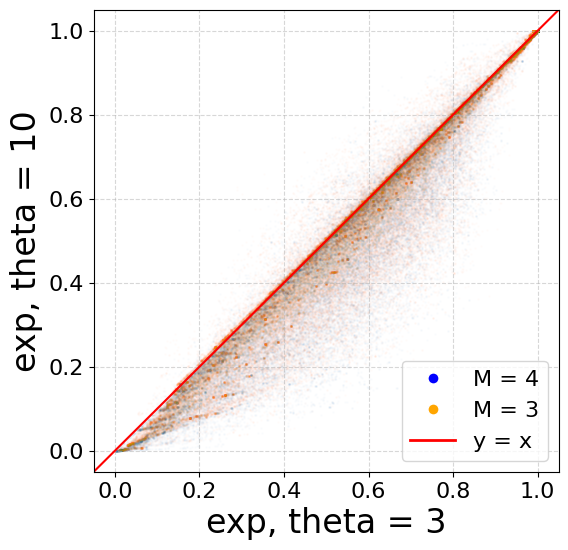

In [7]:
options = [("linear_gain_2_","lin, theta = 2"),("linear_gain_decimal_","lin, theta = .1"),("exponential_gain_2_","exp, theta = 2"),("exponential_gain_3_","exp, theta = 3"),("exponential_gain_10_","exp, theta = 10")]
p_values = [.9,.8,.95]
df = pd.read_csv('./results/run_data.csv')

for p in p_values:
    print(p)
    for o in options:
        current = df[df['p_used'] == p]
        pre_2012 = current[current["year"]<2012]
        post_2012 = current[current["year"]>=2012]
        compare_rbo_scores(post_2012["rbo_locals"], "lin, theta = 1",post_2012[f"{o[0]}local"], o[1],data_x_2=pre_2012["rbo_locals"],data_y_2=pre_2012[f"{o[0]}local"])

    for x in np.arange(len(options)):
        for y in np.arange(x+1,len(options)):
            current = df[df['p_used'] == p]
            pre_2012 = current[current["year"]<2012]
            post_2012 = current[current["year"]>=2012]
            compare_rbo_scores(post_2012[f"{options[x][0]}local"], options[x][1],post_2012[f"{options[y][0]}local"], options[y][1], data_x_2=pre_2012[f"{options[x][0]}local"], data_y_2=pre_2012[f"{options[y][0]}local"])    

0.9


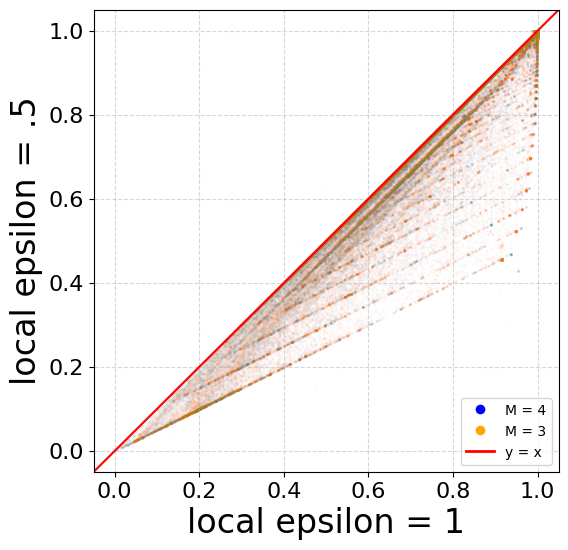

0.8


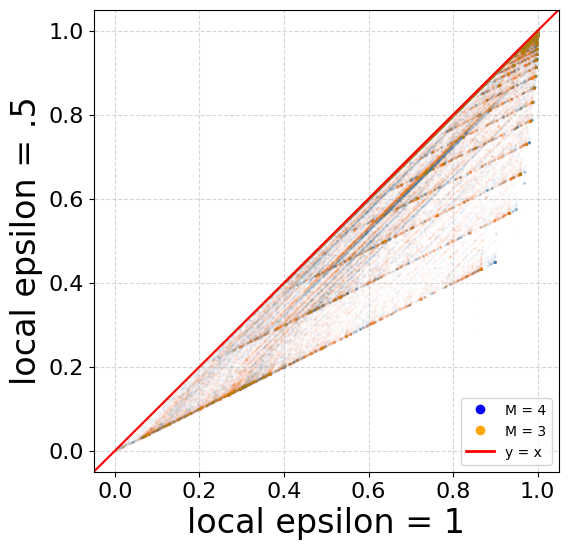

0.95


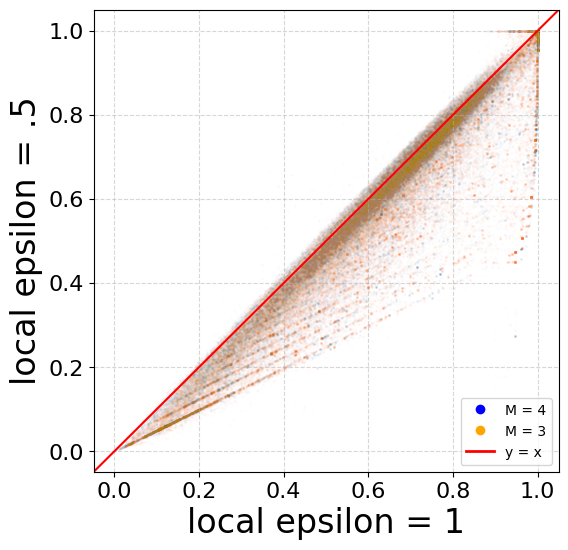

In [68]:
p_values = [.9,.8,.95]
df = pd.read_csv('./results/run_data.csv')

for p in p_values:
    print(p)
    
    current = df[df['p_used'] == p]
    pre_2012 = current[current["year"]<2012]
    post_2012 = current[current["year"]>=2012]
    compare_rbo_scores(post_2012["rbo_locals"], "local epsilon = 1", post_2012["rbo_locals_epsilon_half"], "local epsilon = .5", data_x_2=pre_2012["rbo_locals"],data_y_2=pre_2012["rbo_locals_epsilon_half"])